# Data Exploration

# Header

In [1]:
%%capture
# Install catboost
# !pip install catboost
# !pip install ipywidgets
# !jupyter nbextension enable --py widgetsnbextension

#!pip install folium
!pip install vincenty

In [2]:
# Mount google drive
from google.colab import drive
drive.mount('/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly&response_type=code

Enter your authorization code:
4/3wEGCO_sJWv4D0Vcf8qIMzj8FRup4-b1qUk0FkhUWqaB4P0r6dLlZfQ
Mounted at /gdrive


In [3]:
import os
import sys

os.chdir(r'/gdrive/My Drive/Colab Notebooks/GITHUB/X_PFB')
if "." not in sys.path:
  sys.path.append(".")

In [4]:
import pandas as pd
import numpy as np
from scipy import stats
import pickle
import time
import copy

import matplotlib
import matplotlib.pyplot as plt

import seaborn as sns

from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import GridSearchCV, train_test_split

# import catboost

matplotlib.style.use('fivethirtyeight')
matplotlib.rcParams['font.size'] = 12
matplotlib.rcParams['figure.figsize'] = (10,10)

pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

sns.set(color_codes=True)

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


# Dataset

## Original Data

In [5]:
DATA_DIR = 'data/'
x_train_ori = pd.read_csv(DATA_DIR+'x_train.csv')
y_train_ori = pd.read_csv(DATA_DIR + 'y_train.csv')
x_test_ori = pd.read_csv(DATA_DIR+'x_test.csv')

In [6]:
x_train_ori.shape, y_train_ori.shape, x_test_ori.shape

((219337, 26), (219337, 4), (108033, 26))

In [7]:
x_train_ori.head(3)

,emergency vehicle selection,intervention,alert reason category,alert reason,intervention on public roads,floor,location of the event,longitude intervention,latitude intervention,emergency vehicle,emergency vehicle type,rescue center,selection time,date key sélection,time key sélection,status preceding selection,delta status preceding selection-selection,departed from its rescue center,longitude before departure,latitude before departure,delta position gps previous departure-departure,GPS tracks departure-presentation,GPS tracks datetime departure-presentation,OSRM response,OSRM estimated distance,OSRM estimated duration
0,5105452,13264186,3,2162,0,0,148.0,2.284796,48.879669,4511,VSAV BSPP,2447,2018-07-08 19:02:43.990,20180708,190243,Rentré,2027,1,2.288053,48.884698,NaN,"2.289000,48.885113;2.288861,48.884998;2.288000...",2018-07-08 19:04:43;2018-07-08 19:05:55;2018-0...,"{""code"":""Ok"",""routes"":[{""geometry"":""}yjiH}x}L_...",952.5,105.8
1,4720915,12663715,3,2124,0,1,136.0,2.247464,48.818191,4327,PSE,2464,2018-01-04 09:02:59.470,20180104,90259,Rentré,28233,1,2.268519,48.823958,NaN,NaN,NaN,"{""code"":""Ok"",""routes"":[{""geometry"":""u|~hHy`zL_...",2238.5,243.2
2,5365374,13675521,3,2163,0,2,139.0,2.258328,48.836759,4509,VSAV BSPP,2438,2018-11-16 10:11:47.777,20181116,101147,Disponible,1981,0,2.272944,48.850498,33.0,"2.272972,48.850498;2.269056,48.847443;2.262611...",2018-11-16 10:14:31;2018-11-16 10:15:43;2018-1...,"{""code"":""Ok"",""routes"":[{""geometry"":""_cdiHo}zLm...",3026.4,295.4


## Prepared data

In [8]:
DATA_DIR = 'data/'
#x_train = pickle.load(open(DATA_DIR + 'x_train.beforeOneHot.pickle', 'rb'))
x_train = pd.read_csv(DATA_DIR+'prepared/x_train.csv.zip', compression='zip')
y_train = pd.read_csv(DATA_DIR + 'y_train.csv')
x_test = pd.read_csv(DATA_DIR+'prepared/x_test.csv.zip', compression='zip')

x_train.shape, x_test.shape

((219337, 64), (108033, 64))

In [9]:
cat_features = ['alert reason category', 'alert reason', 'intervention on public roads', 'floor', 
                'location of the event', 'emergency vehicle', 'emergency vehicle type', 'rescue center', 
                'status preceding selection', 'departed from its rescue center', 
                'selection_weekday', 'selection_month', 'selection_day', 'selection_hour', 'selection_is_holiday',
                 # New!
                'waypoint1_name', 'waypoint2_name',
                ]
cat_features_idx = [i for i, name in enumerate(x_train.columns) if name in cat_features]
Y_NAMES = list(y_train.columns[1:3].values)
print(Y_NAMES)
print(cat_features)
print(cat_features_idx)

y_name = Y_NAMES[1]

['delta selection-departure', 'delta departure-presentation']
['alert reason category', 'alert reason', 'intervention on public roads', 'floor', 'location of the event', 'emergency vehicle', 'emergency vehicle type', 'rescue center', 'status preceding selection', 'departed from its rescue center', 'selection_weekday', 'selection_month', 'selection_day', 'selection_hour', 'selection_is_holiday', 'waypoint1_name', 'waypoint2_name']
[0, 1, 2, 3, 4, 7, 8, 11, 13, 23, 24, 25, 26, 27, 32, 35]


In [10]:
x_train_sp, x_test_sp, y_train_sp, y_test_sp = train_test_split(
    x_train,
    y_train, 
    test_size=0.33, 
    random_state=42)
x_train.shape, x_test_sp.shape

((219337, 64), (72382, 64))

In [11]:
xy_train = pd.concat([x_train, y_train], axis=1)

In [12]:
xy_train_subset = xy_train[xy_train['delta selection-presentation'] <= 20*60]

In [13]:
xy_train.dtypes

alert reason category           int64
alert reason                    int64
intervention on public roads    int64
floor                           int64
location of the event           int64
                                ...  
intervention_place              int64
emergency vehicle selection     int64
delta selection-departure       int64
delta departure-presentation    int64
delta selection-presentation    int64
Length: 68, dtype: object

In [14]:
xy_train.head(3)

,alert reason category,alert reason,intervention on public roads,floor,location of the event,longitude intervention,latitude intervention,emergency vehicle,rescue center,date key sélection,time key sélection,status preceding selection,delta status preceding selection-selection,departed from its rescue center,longitude before departure,latitude before departure,delta position gps previous departure-departure,OSRM estimated distance,OSRM estimated duration,OSRM estimated distance from last observed GPS position,OSRM estimated duration from last observed GPS position,time elapsed between selection and last observed GPS position,updated OSRM estimated duration,selection_weekday,selection_month,selection_day,selection_hour,selection_is_holiday,OSRM_estimated_speed,departure2intervention_bearing,mid_point_lat,mid_point_lon,waypoint1_name,waypoint1_lon,waypoint1_lat,waypoint2_name,waypoint2_lon,waypoint2_lat,waypoint3_name,waypoint3_lon,waypoint3_lat,waypoint4_name,waypoint4_lon,waypoint4_lat,paris2intervention_bearing,paris2intervention_km,paris2departure_bearing,paris2departure_km,paris2mid_point_bearing,paris2mid_point_km,paris2waypoint1_bearing,paris2waypoint1_km,paris2waypoint2_bearing,paris2waypoint2_km,GPS_Tracks_records,GPS_Tracks_duration_hr,GPS_Tracks_distance_km,GPS_Tracks_mean_kmh,GPS_Tracks_std_kmh,GPS_Tracks_80pc_kmh,vehicule_type,vehicule_ownrer,speed_mean_kmh,intervention_place,emergency vehicle selection,delta selection-departure,delta departure-presentation,delta selection-presentation
0,3,2162,0,0,148,2.284796,48.879669,4511,2447,20180708,190243,Rentré,2027,1,2.288053,48.884698,0.0,952.5,105.8,663.2,88.8,394.010,482.810,6,7,8,19,False,9.002836,203.070219,48.882184,2.286424,Boulevard de l'Yser,2.287674,48.884954,Boulevard Gouvion-Saint-Cyr,2.284755,48.879677,Boulevard de l'Yser,2.286240,48.880195,Boulevard Gouvion-Saint-Cyr,2.284755,48.879677,297.513299,5.570931,303.685128,5.648822,300.621080,5.601765,303.769415,5.687728,297.507185,5.574011,5,0.076389,1.024271,13.417797,10.365761,19.955243,VSAV,BSPP,22.324400,226,5105452,86,324,410
1,3,2124,0,1,136,2.247464,48.818191,4327,2464,20180104,90259,Rentré,28233,1,2.268519,48.823958,0.0,2238.5,243.2,0.0,0.0,0.000,0.000,3,1,4,9,False,9.204359,247.420464,48.821075,2.257991,Missing,2.268451,48.823945,Avenue de Verdun,2.247447,48.818154,Missing,0.000000,0.000000,Avenue de Verdun,0.000000,0.000000,240.914608,8.795420,239.377252,7.135055,240.226026,7.964531,239.387686,7.140089,240.895118,8.798512,0,0.000000,0.000000,0.000000,0.000000,0.000000,PSE,Missing,27.706635,164,4720915,164,297,461
2,3,2163,0,2,139,2.258328,48.836759,4509,2438,20181116,101147,Disponible,1981,0,2.272944,48.850498,33.0,3026.4,295.4,802.2,106.1,451.223,557.323,4,11,16,10,False,10.245091,215.002360,48.843629,2.265635,Rue François Millet,2.273041,48.850556,Avenue Dode de la Brunerie,2.258263,48.836243,Rue François Millet,2.257918,48.836261,Avenue Dode de la Brunerie,2.258263,48.836243,252.229258,7.234524,263.356004,5.855739,257.204175,6.514804,263.410805,5.847920,251.808384,7.256797,5,0.080000,1.972331,24.439356,14.619992,32.745709,VSAV,BSPP,26.491018,184,5365374,125,365,490


In [15]:
# Distinct waypoints
cols = [f'waypoint{i}_name' for i in range(1,5)]
pd.concat([x_train[cols[i]] for i in range(4)], axis=0).unique().shape

(12311,)

# Helpers for Visualization

In [16]:
# import helpers.run_model as run_model

In [17]:
import matplotlib.gridspec as gridspec
import pandas.api.types

def my_plot_dist(df, col_names):
    n = len(col_names)
    grid_n_col = 3
    grid_n_row = int(np.ceil(n/grid_n_col))
    fig = plt.figure(figsize=(4* grid_n_col, 3*grid_n_row))
    gs = gridspec.GridSpec(ncols=grid_n_col, nrows=grid_n_row, figure=fig)    
    for i, col in enumerate(col_names):
        ax = fig.add_subplot(gs[i // grid_n_col, i % grid_n_col])
        if pandas.api.types.is_categorical_dtype(df[col].dtype):
            if pandas.api.types.is_numeric_dtype(df[col].dtype.categories.dtype):
                sns.distplot(df[col].dropna(), label=col, ax=ax)
            else:
                sns.countplot(x=col, data=df, ax=ax)
        elif pandas.api.types.is_numeric_dtype(df[col].dtype):
            sns.distplot(df[col].dropna(), label=col, ax=ax)
        else:
            ax.set_title(col)
    plt.tight_layout()
    plt.show()

# Dependent Variables Ys

## Ys distribution
Extreme values in response variables: find values up to 6 hours!

In [18]:
y_stat = y_train.iloc[:, 1:].describe()
y_stat

,delta selection-departure,delta departure-presentation,delta selection-presentation
count,219337.000000,219337.000000,219337.000000
mean,138.771808,356.161026,494.932834
std,77.710577,228.381939,243.194825
min,0.000000,1.000000,4.000000
25%,100.000000,231.000000,363.000000
50%,131.000000,319.000000,458.000000
75%,168.000000,434.000000,581.000000
max,17758.000000,22722.000000,22934.000000


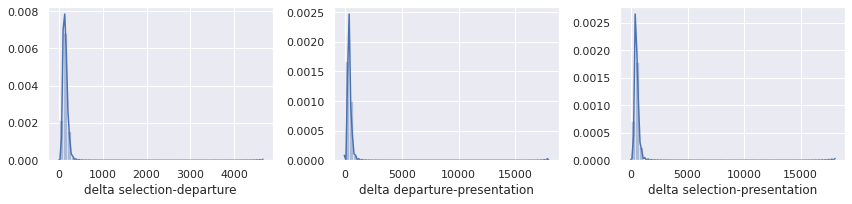

In [19]:
my_plot_dist(y_train.sample(frac=0.2), y_train.columns[1:])

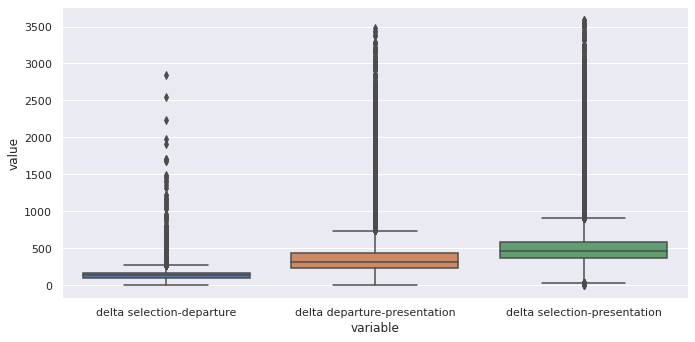

In [20]:
# Y < 20 minutes
plt.figure(figsize=(10,5))
y_names = list(y_train.columns[1:].values)
y_train_limit = y_train[y_train['delta selection-presentation'] < 60*60]
sns.boxplot(data=y_train_limit.melt(value_vars=y_names), 
            x = 'variable',
            y='value')

In [21]:
from scipy.stats import skew, kurtosis
pd.DataFrame({
    'Y': y_names,
    'Skew': [skew(y_train[c]) for c in y_names],
    'Kurtosis': [kurtosis(y_train[c]) for c in y_names],
})

,Y,Skew,Kurtosis
0,delta selection-departure,74.323608,14623.849559
1,delta departure-presentation,17.157254,1089.749990
2,delta selection-presentation,17.169502,1025.978625


In [22]:
#@title No correlations between Ys

corr_mat = y_train[Y_NAMES].corr(method='pearson')
corr_mat

,delta selection-departure,delta departure-presentation
delta selection-departure,1.000000,0.026665
delta departure-presentation,0.026665,1.000000


## Ys outliers

In [33]:
y_stat = y_train.iloc[:,1:].describe()

In [34]:
# All values > mean + 3 * std
m = []
for c in y_stat.columns:
  m.append(y_stat[c]['mean'] + 3.0 * y_stat[c]['std'])
m

[371.9035384749177, 1041.3068440844527, 1224.5173098783553]

In [35]:
z = y_train.iloc[:,1:]
cols = y_stat.columns
z[(z[cols[0]] > m[0]) | (z[cols[1]] > m[1]) | (z[cols[2]] > m[2])].describe()

,delta selection-departure,delta departure-presentation,delta selection-presentation
count,2945.000000,2945.000000,2945.000000
mean,279.134465,1194.849576,1473.984041
std,473.240201,1123.166879,1154.084151
min,1.000000,3.000000,414.000000
25%,121.000000,590.000000,1088.000000
50%,188.000000,1131.000000,1301.000000
75%,394.000000,1390.000000,1576.000000
max,17758.000000,22722.000000,22934.000000


In [36]:
z[(z[cols[2]] > m[2])].sort_values('delta selection-departure', ascending=False).head(20)

,delta selection-departure,delta departure-presentation,delta selection-presentation
187523,17758,452,18210
6810,11753,1981,13734
92333,6171,1180,7351
20345,4642,1734,6376
94517,3791,383,4174
40554,3665,824,4489
84101,3422,469,3891
31197,2848,485,3333
169142,2550,503,3053
159599,2289,2327,4616


In [37]:
z[(z[cols[2]] > m[2])].sort_values('delta departure-presentation', ascending=False).head(20)


,delta selection-departure,delta departure-presentation,delta selection-presentation
208599,212,22722,22934
183804,59,18895,18954
194509,85,17895,17980
120233,188,16729,16917
196126,223,12454,12677
107809,251,11891,12142
3142,95,11489,11584
208675,91,9754,9845
93599,94,9279,9373
6742,107,8516,8623


Text(0.5, 1.0, 'delta selection-presentation')

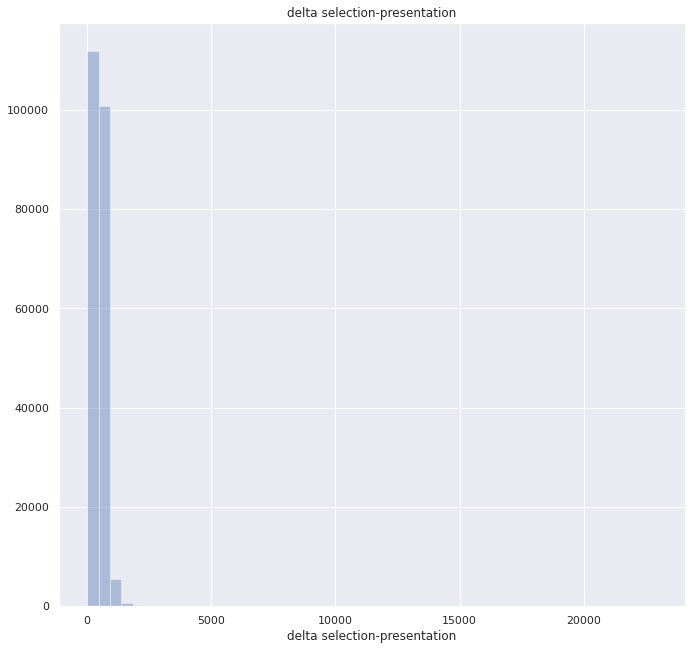

In [38]:
ax = plt.subplot()
sns.distplot(z['delta selection-presentation'], 
             kde=False, rug=False, 
             ax=ax)
ax.set_title('delta selection-presentation')

## Subset of data with duration <= 20mn

In [39]:
# xy_train_subset = xy_train[xy_train['delta selection-presentation'] <= 20*60]

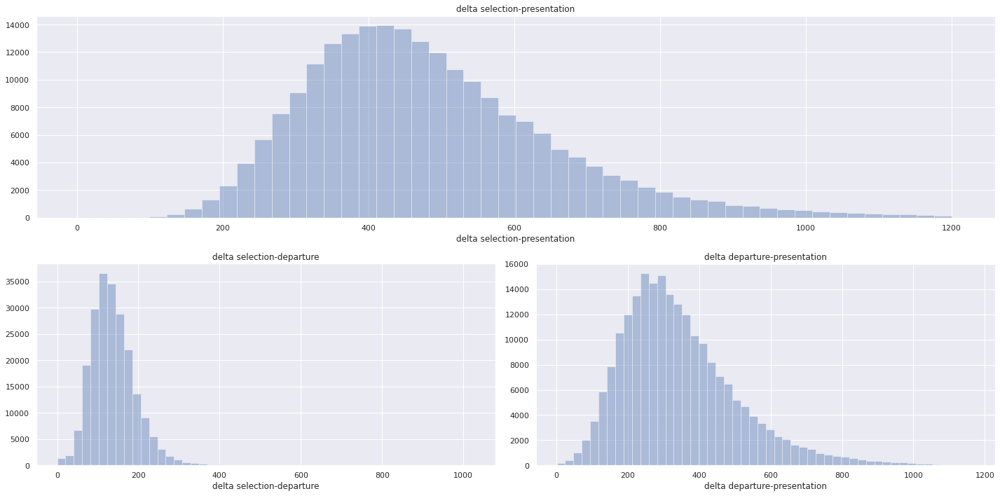

In [40]:
# Limit to 20 minutes (total time)

fig = plt.figure(figsize=(20,10))
gs = fig.add_gridspec(2,2)

y_name = 'delta selection-presentation'
ax = fig.add_subplot(gs[0,:])
sns.distplot(xy_train_subset[y_name], 
             kde=False, rug=False, 
             ax=ax)
ax.set_title(y_name)

y_name = 'delta selection-departure'
ax = fig.add_subplot(gs[1,0])
sns.distplot(xy_train_subset[y_name], 
             kde=False, rug=False, 
             ax=ax)
ax.set_title(y_name)

y_name = 'delta departure-presentation'
ax = fig.add_subplot(gs[1,1])
sns.distplot(xy_train_subset[y_name],  
             kde=False, rug=False, 
             ax=ax)
ax.set_title(y_name)

plt.tight_layout()
plt.show()

# Most of durations are within 2 minutes and 20 minutes

In [41]:
# Distribution of the duration
# Vast majority is under 10 minutes.
# There are few that exceed 20mn.
bins = np.array([1, 5, 10, 20, 30, 40]) * 60  # Discretize the duration by bins
groups = y_train.groupby(pd.cut(y_train['delta selection-presentation'], bins))
z = pd.DataFrame(groups.size(), columns=['# occurrences'])
z['%'] = z['# occurrences'] * 100 / x_train.shape[0]
z

,# occurrences,%
delta selection-presentation,,
"(60, 300]",25182,11.480963
"(300, 600]",145702,66.428373
"(600, 1200]",46364,21.138248
"(1200, 1800]",1530,0.697557
"(1800, 2400]",287,0.130849


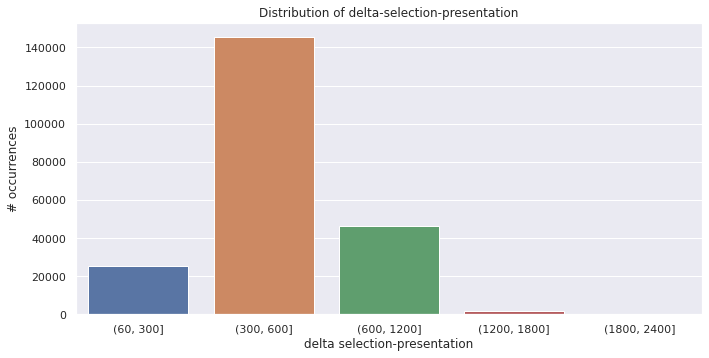

In [42]:
plt.figure(figsize=(10,5))
ax = plt.subplot(111)
sns.barplot(x=z.index, y=z['# occurrences'], ax=ax)
ax.set_title('Distribution of delta-selection-presentation')
plt.show()

# Correlation between Y and other variables

## Y2 Total duration ('selection-presentation') vs feature vars

In [43]:
x_train.head(2)

,alert reason category,alert reason,intervention on public roads,floor,location of the event,longitude intervention,latitude intervention,emergency vehicle,rescue center,date key sélection,time key sélection,status preceding selection,delta status preceding selection-selection,departed from its rescue center,longitude before departure,latitude before departure,delta position gps previous departure-departure,OSRM estimated distance,OSRM estimated duration,OSRM estimated distance from last observed GPS position,OSRM estimated duration from last observed GPS position,time elapsed between selection and last observed GPS position,updated OSRM estimated duration,selection_weekday,selection_month,selection_day,selection_hour,selection_is_holiday,OSRM_estimated_speed,departure2intervention_bearing,mid_point_lat,mid_point_lon,waypoint1_name,waypoint1_lon,waypoint1_lat,waypoint2_name,waypoint2_lon,waypoint2_lat,waypoint3_name,waypoint3_lon,waypoint3_lat,waypoint4_name,waypoint4_lon,waypoint4_lat,paris2intervention_bearing,paris2intervention_km,paris2departure_bearing,paris2departure_km,paris2mid_point_bearing,paris2mid_point_km,paris2waypoint1_bearing,paris2waypoint1_km,paris2waypoint2_bearing,paris2waypoint2_km,GPS_Tracks_records,GPS_Tracks_duration_hr,GPS_Tracks_distance_km,GPS_Tracks_mean_kmh,GPS_Tracks_std_kmh,GPS_Tracks_80pc_kmh,vehicule_type,vehicule_ownrer,speed_mean_kmh,intervention_place
0,3,2162,0,0,148,2.284796,48.879669,4511,2447,20180708,190243,Rentré,2027,1,2.288053,48.884698,0.0,952.5,105.8,663.2,88.8,394.01,482.81,6,7,8,19,False,9.002836,203.070219,48.882184,2.286424,Boulevard de l'Yser,2.287674,48.884954,Boulevard Gouvion-Saint-Cyr,2.284755,48.879677,Boulevard de l'Yser,2.28624,48.880195,Boulevard Gouvion-Saint-Cyr,2.284755,48.879677,297.513299,5.570931,303.685128,5.648822,300.621080,5.601765,303.769415,5.687728,297.507185,5.574011,5,0.076389,1.024271,13.417797,10.365761,19.955243,VSAV,BSPP,22.324400,226
1,3,2124,0,1,136,2.247464,48.818191,4327,2464,20180104,90259,Rentré,28233,1,2.268519,48.823958,0.0,2238.5,243.2,0.0,0.0,0.00,0.00,3,1,4,9,False,9.204359,247.420464,48.821075,2.257991,Missing,2.268451,48.823945,Avenue de Verdun,2.247447,48.818154,Missing,0.00000,0.000000,Avenue de Verdun,0.000000,0.000000,240.914608,8.795420,239.377252,7.135055,240.226026,7.964531,239.387686,7.140089,240.895118,8.798512,0,0.000000,0.000000,0.000000,0.000000,0.000000,PSE,Missing,27.706635,164


In [44]:
def my_plot_scatter(df, df_y, col_names, target_name):
    n = len(col_names)
    grid_n_col = 3
    grid_n_row = int(np.ceil(n/grid_n_col))
    fig = plt.figure(figsize=(4* grid_n_col, 3*grid_n_row))
    gs = gridspec.GridSpec(ncols=grid_n_col, nrows=grid_n_row, figure=fig)    
    for i, col in enumerate(col_names):
        print(col)
        z = pd.DataFrame( {
            col: df[col], 
            target_name: df_y[target_name]
            })
        ax = fig.add_subplot(gs[i // grid_n_col, i % grid_n_col])
        #sns.distplot(df[col].dropna(), label=col, ax=ax)
        sns.scatterplot(col, target_name, 
                        data=z.dropna(), 
                        ax=ax,
                        )
        if df[col].dtype in (int, float):
          corr_coef = np.corrcoef(df[col].astype(float),
                                  df_y[target_name].astype(float))[0,1]
          ax.set_title(f'Corr coef={corr_coef:0.3f}')
        else:
          ax.set_title(f'')
    plt.tight_layout(pad=2.0)
    plt.show();

In [45]:
np.corrcoef(x_train['GPS_Tracks_duration_hr'].astype(float), y_train['delta selection-presentation'].astype(float))[0,1],\
np.corrcoef(x_train['GPS_Tracks_records'].astype(float), y_train['delta selection-presentation'].astype(float))[0,1]

(0.34075302051050504, 0.2937847925940527)

In [46]:
import random
idx = random.sample(range(x_train_ori.shape[0]), 3000)
excl = [
    'GPS tracks departure-presentation',
    'GPS tracks datetime departure-presentation',
    'OSRM response',
    # 'date key sélection',
    # 'time key sélection'
    ]
cols = [c for c in x_train_ori.columns if c not in excl]
cols

['emergency vehicle selection',
 'intervention',
 'alert reason category',
 'alert reason',
 'intervention on public roads',
 'floor',
 'location of the event',
 'longitude intervention',
 'latitude intervention',
 'emergency vehicle',
 'emergency vehicle type',
 'rescue center',
 'selection time',
 'date key sélection',
 'time key sélection',
 'status preceding selection',
 'delta status preceding selection-selection',
 'departed from its rescue center',
 'longitude before departure',
 'latitude before departure',
 'delta position gps previous departure-departure',
 'OSRM estimated distance',
 'OSRM estimated duration']

emergency vehicle selection
intervention
alert reason category
alert reason
intervention on public roads
floor
location of the event
longitude intervention
latitude intervention
emergency vehicle
emergency vehicle type
rescue center


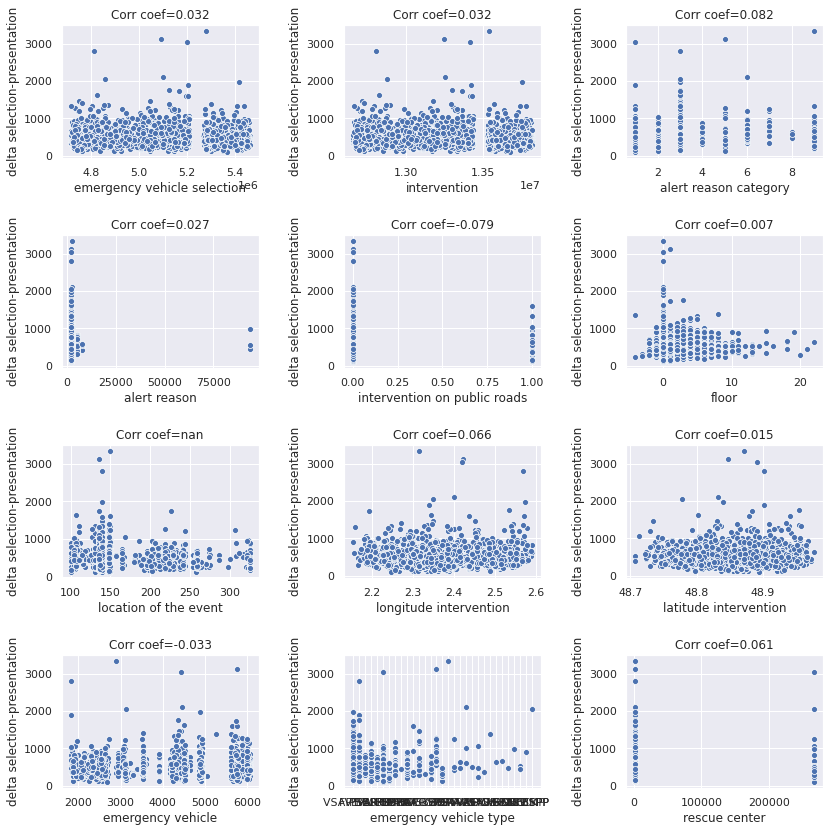

In [47]:
my_plot_scatter(x_train_ori.iloc[idx,:], y_train_ori.iloc[idx,:],
                cols[:12], 
                'delta selection-presentation')

In [48]:
cols[13:]

['date key sélection',
 'time key sélection',
 'status preceding selection',
 'delta status preceding selection-selection',
 'departed from its rescue center',
 'longitude before departure',
 'latitude before departure',
 'delta position gps previous departure-departure',
 'OSRM estimated distance',
 'OSRM estimated duration']

date key sélection
time key sélection
status preceding selection
delta status preceding selection-selection
departed from its rescue center
longitude before departure
latitude before departure
delta position gps previous departure-departure
OSRM estimated distance
OSRM estimated duration


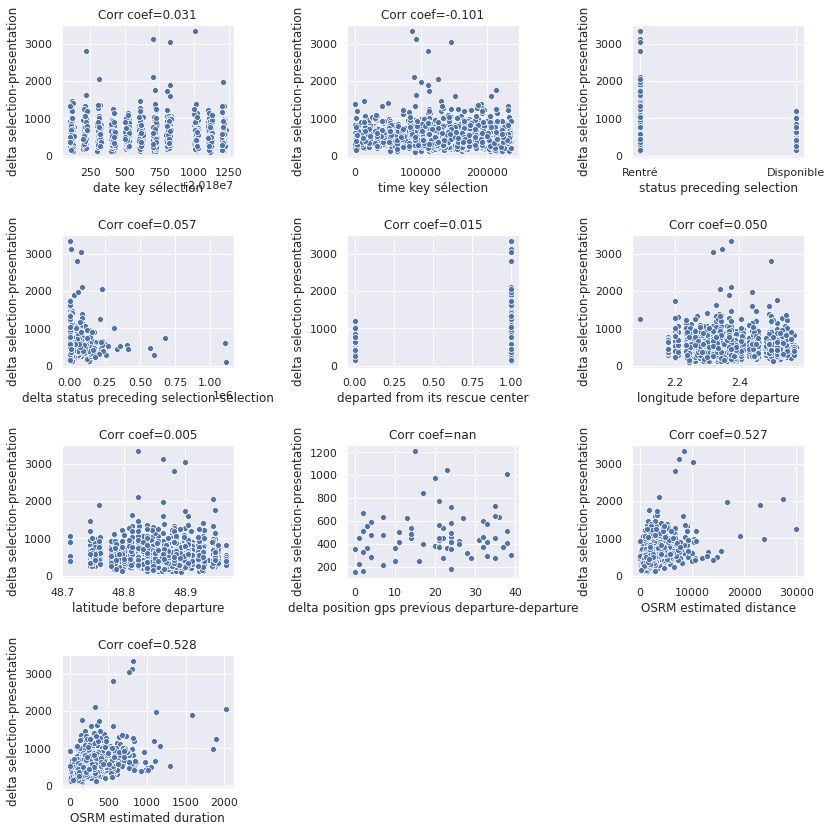

In [49]:
my_plot_scatter(x_train_ori.iloc[idx,:], y_train_ori.iloc[idx,:],
                cols[13:], 
                'delta selection-presentation')

/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:2264: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


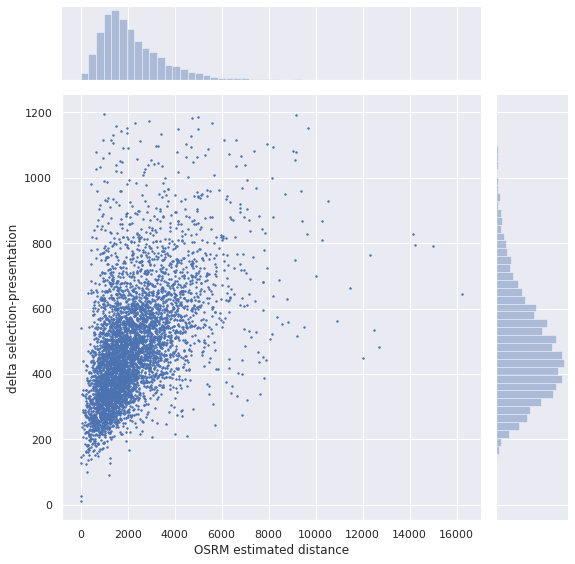

In [50]:
# Plot Y (departure-selection) vs Distance
sns.jointplot(x='OSRM estimated distance', 
              y='delta selection-presentation', 
              data=xy_train_subset.sample(n=5000),
              s=2,
              size=8,)

/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:2264: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


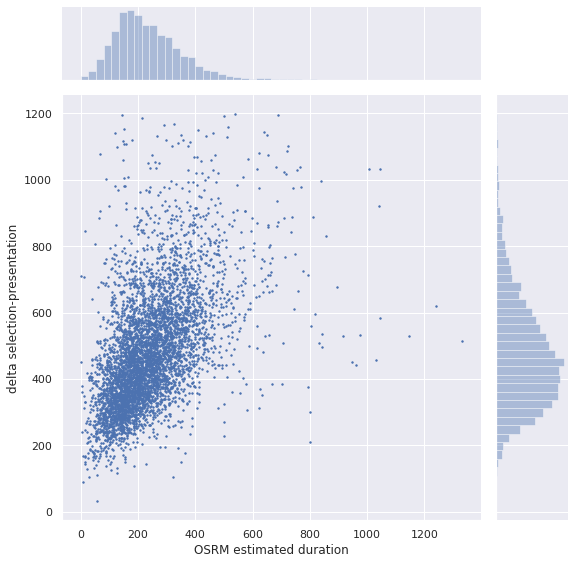

In [51]:
# Plot Y (departure-selection) vs estimated duration
sns.jointplot(x='OSRM estimated duration', 
              y='delta selection-presentation', 
              data=xy_train_subset.sample(n=5000),
              s=2,
              size=8,
              #kind='reg'
              )

## Y1 'departure-presentation' vs feature vars

In [52]:
y_train.head()

,emergency vehicle selection,delta selection-departure,delta departure-presentation,delta selection-presentation
0,5105452,86,324,410
1,4720915,164,297,461
2,5365374,125,365,490
3,4741586,168,160,328
4,5381209,138,523,661


alert reason category
alert reason
intervention on public roads
floor
location of the event
longitude intervention
latitude intervention
emergency vehicle
rescue center
date key sélection
time key sélection
status preceding selection
delta status preceding selection-selection
departed from its rescue center
longitude before departure
latitude before departure
delta position gps previous departure-departure
OSRM estimated distance
OSRM estimated duration


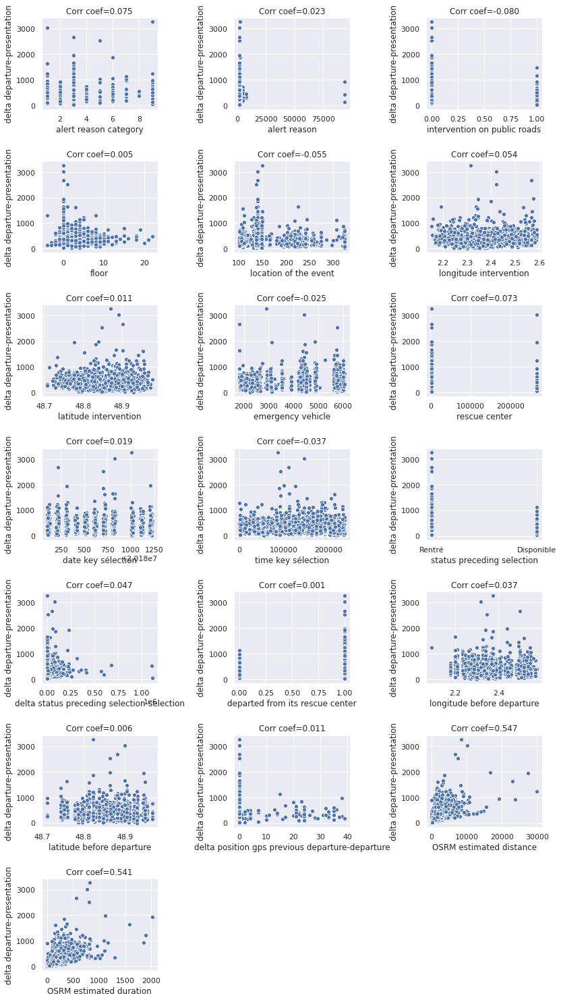

In [57]:
my_plot_scatter(x_train.iloc[idx,:], y_train.iloc[idx,:], 
                [c for c in cols if c in x_train.columns], 
                'delta departure-presentation')

## Y0 'selection-departure' vs feature vars

alert reason category
alert reason
intervention on public roads
floor
location of the event
longitude intervention
latitude intervention
emergency vehicle
rescue center
date key sélection
time key sélection
status preceding selection
delta status preceding selection-selection
departed from its rescue center
longitude before departure
latitude before departure
delta position gps previous departure-departure
OSRM estimated distance
OSRM estimated duration


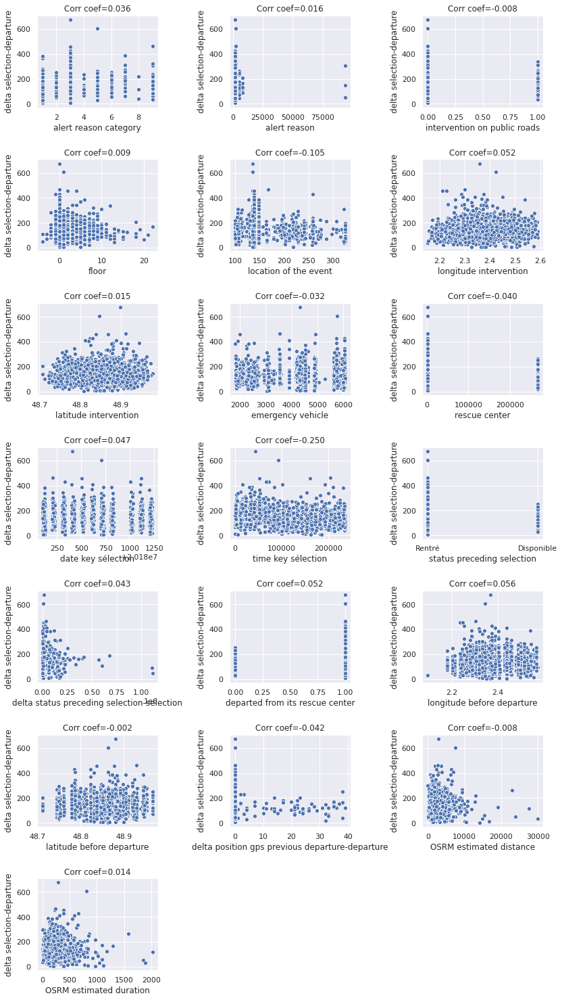

In [58]:
my_plot_scatter(x_train.iloc[idx,:], y_train.iloc[idx,:], 
                [c for c in cols if c in x_train.columns], 
                'delta selection-departure')

# How top influencer predictors and speed correlate?

## 'alert reason' and speed mean


In [60]:
x_train['alert reason'].value_counts().head(20)

2162    68515
2112    37332
2113    23112
2163    15272
1922    13339
2135     7559
2124     5927
2711     5919
2134     3413
2120     3392
5062     2964
2421     2568
2119     2214
2011     2057
1941     2056
2018     1984
2118     1765
2136     1675
2017     1562
1918     1389
Name: alert reason, dtype: int64

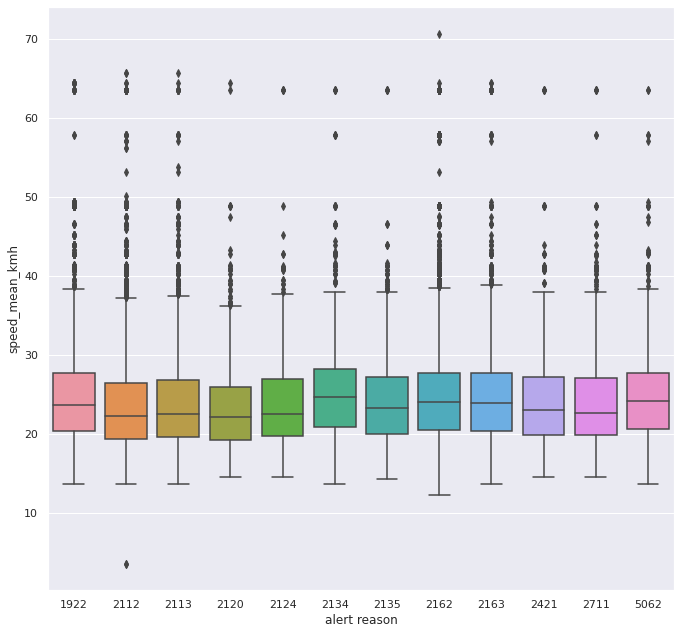

In [61]:
# 12 most frequent alert reason and their avg speed
l = x_train['alert reason'].value_counts().head(12).index.tolist()
sns.boxplot(x='alert reason', y='speed_mean_kmh', 
            data=xy_train_subset[xy_train_subset['alert reason'].isin(l)]
            )

## 'rescue center' and speed mean

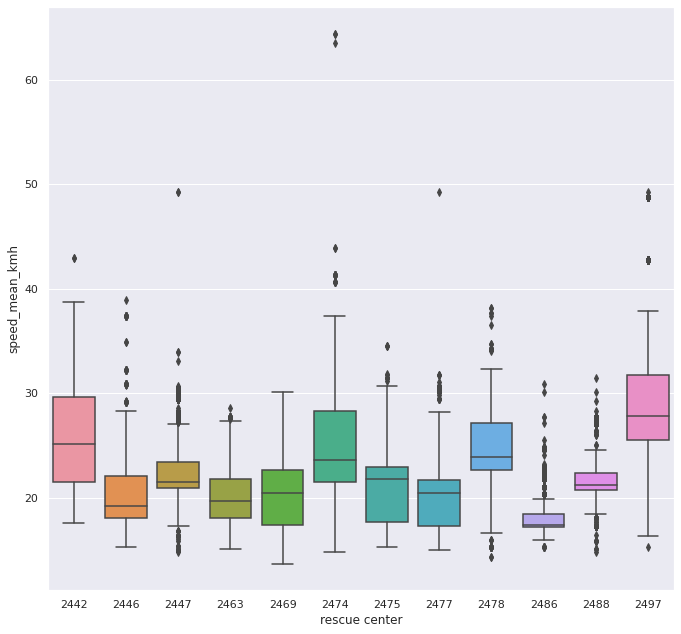

In [62]:
# 12 most frequent 'rescue center' and their avg speed
l = x_train['rescue center'].value_counts().head(12).index.tolist()
sns.boxplot(x='rescue center', y='speed_mean_kmh', 
            data=xy_train_subset[xy_train_subset['rescue center'].isin(l)]
            )

## 'alert reason type' and speed

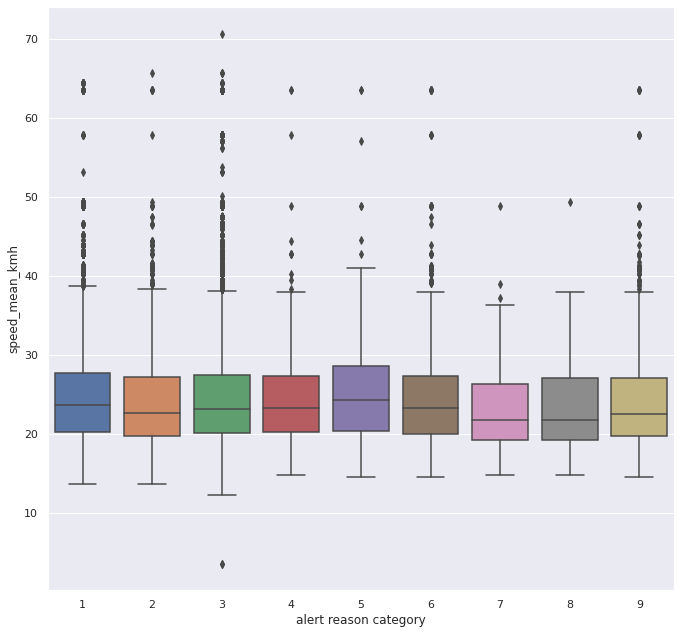

In [63]:
l = x_train['alert reason category'].value_counts().head(12).index.tolist()
sns.boxplot(x='alert reason category', y='speed_mean_kmh', 
            data=xy_train_subset[xy_train_subset['alert reason category'].isin(l)]
            )

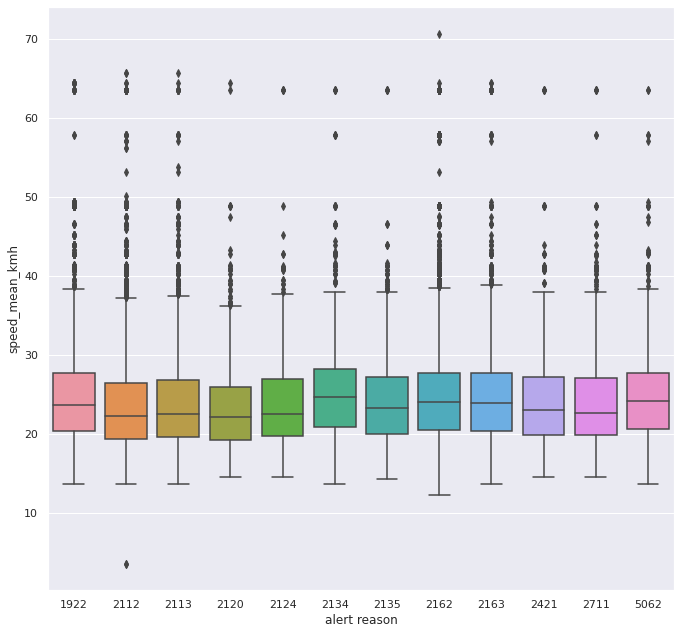

In [64]:
l = x_train['alert reason'].value_counts().head(12).index.tolist()
sns.boxplot(x='alert reason', y='speed_mean_kmh', 
            data=xy_train_subset[xy_train_subset['alert reason'].isin(l)]
            )

# Spatial features

In [65]:
# Displays the distribution of the intervention coordinates
# Circles represent the different level of percentiles: 0.95, 0.85, 0.75
# The center of circles is the median coordinate
import folium
from vincenty import vincenty 
def display_coord_percentile(df, percents, lat_col_name, lon_col_name):
    center_coord = (df[lat_col_name].median(),  df[lon_col_name].median())
    my_map = folium.Map(location = center_coord, zoom_start = 11)
    folium.Marker(center_coord, popup = 'median').add_to(my_map)
    for percent in percents:
        pct_coord = (df[lat_col_name].quantile(percent),  df[lon_col_name].quantile(percent))
        radius = vincenty(center_coord, pct_coord)*1000 # km to m
        folium.Circle(
            center_coord,
            radius=radius,
            color='green', 
            fill=True, fill_color='green', fill_opacity=0.2).add_to(my_map)
    return my_map
    
display_coord_percentile(df=x_train, percents=[0.95, 0.85, 0.75 ], 
                         lat_col_name='latitude intervention', lon_col_name='longitude intervention')

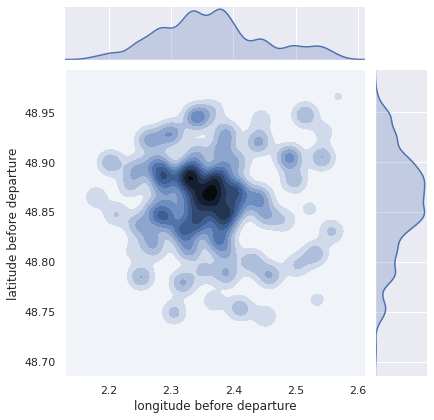

In [66]:
z=x_train.sample(n=5000)
sns.jointplot(y='latitude before departure', x='longitude before departure', data=z, kind='kde')
# Departure places (casernes)

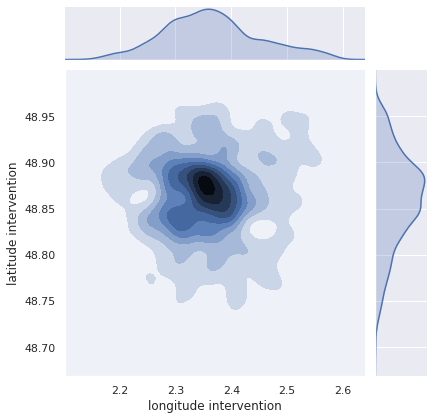

In [67]:
sns.jointplot(y='latitude intervention', x='longitude intervention', data=z, kind='kde')
# Intervention places

/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:1665: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:1734: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  f.tight_layout()


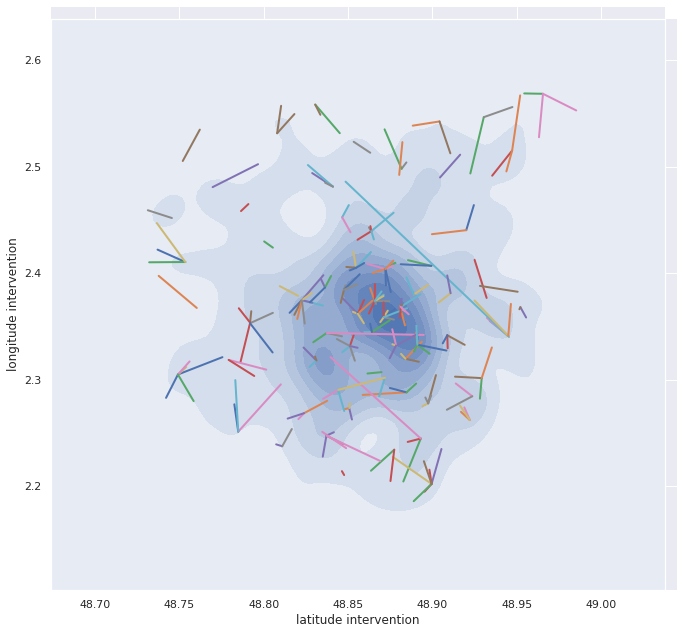

In [68]:
# Trajectories
z2 = x_train.sample(n=5000)
grid = sns.JointGrid(z2['latitude intervention'], z2['longitude intervention'], space=0, size=10, ratio=50)
grid.plot_joint(sns.kdeplot, shade=True)
#for i in [52813, 216922, 189613]:
for i in z2.index.values[:200]:
  dep_arr = z2.loc[i,['latitude before departure','longitude before departure','latitude intervention', 'longitude intervention']].values
  plt.plot([dep_arr[0], dep_arr[2]], [dep_arr[1], dep_arr[3]], linewidth=2)

## Heatmap on GPS coordinates


In [69]:
def display_heatmap(df, lat_colname, lon_colname, val_colname, agg_fct, **args):
  '''
  display_heatmap(df=xy_train_subset.sample(3000), lat_colname='latitude intervention', 
                  lon_colname='longitude intervention', 
                  val_colname='delta selection-presentation',
                  agg_fct='median')
  '''
  # aggregate by latitudexlongitude median
  z = df[[lat_colname, lon_colname, val_colname]]
  z[lat_colname] = z[lat_colname].round(2)
  z[lon_colname] = z[lon_colname].round(2)
  z = z.groupby([lat_colname, lon_colname]).agg(agg_fct)
  z.reset_index(inplace=True)
  # makes crosstable
  z = z.pivot(index=lat_colname, columns=lon_colname, values=val_colname)
  # heatmap
  cmap = 'RdBu_r' #sns.cm.rocket_r
  plt.figure(figsize=(12,12))
  ax = plt.subplot(111)
  g = sns.heatmap(z, cmap=cmap, ax=ax, linewidths=.5, **args)
  #plt.show()
  return z

In [70]:
xy_train_subset.head(1)

,alert reason category,alert reason,intervention on public roads,floor,location of the event,longitude intervention,latitude intervention,emergency vehicle,rescue center,date key sélection,time key sélection,status preceding selection,delta status preceding selection-selection,departed from its rescue center,longitude before departure,latitude before departure,delta position gps previous departure-departure,OSRM estimated distance,OSRM estimated duration,OSRM estimated distance from last observed GPS position,OSRM estimated duration from last observed GPS position,time elapsed between selection and last observed GPS position,updated OSRM estimated duration,selection_weekday,selection_month,selection_day,selection_hour,selection_is_holiday,OSRM_estimated_speed,departure2intervention_bearing,mid_point_lat,mid_point_lon,waypoint1_name,waypoint1_lon,waypoint1_lat,waypoint2_name,waypoint2_lon,waypoint2_lat,waypoint3_name,waypoint3_lon,waypoint3_lat,waypoint4_name,waypoint4_lon,waypoint4_lat,paris2intervention_bearing,paris2intervention_km,paris2departure_bearing,paris2departure_km,paris2mid_point_bearing,paris2mid_point_km,paris2waypoint1_bearing,paris2waypoint1_km,paris2waypoint2_bearing,paris2waypoint2_km,GPS_Tracks_records,GPS_Tracks_duration_hr,GPS_Tracks_distance_km,GPS_Tracks_mean_kmh,GPS_Tracks_std_kmh,GPS_Tracks_80pc_kmh,vehicule_type,vehicule_ownrer,speed_mean_kmh,intervention_place,emergency vehicle selection,delta selection-departure,delta departure-presentation,delta selection-presentation
0,3,2162,0,0,148,2.284796,48.879669,4511,2447,20180708,190243,Rentré,2027,1,2.288053,48.884698,0.0,952.5,105.8,663.2,88.8,394.01,482.81,6,7,8,19,False,9.002836,203.070219,48.882184,2.286424,Boulevard de l'Yser,2.287674,48.884954,Boulevard Gouvion-Saint-Cyr,2.284755,48.879677,Boulevard de l'Yser,2.28624,48.880195,Boulevard Gouvion-Saint-Cyr,2.284755,48.879677,297.513299,5.570931,303.685128,5.648822,300.62108,5.601765,303.769415,5.687728,297.507185,5.574011,5,0.076389,1.024271,13.417797,10.365761,19.955243,VSAV,BSPP,22.3244,226,5105452,86,324,410


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()


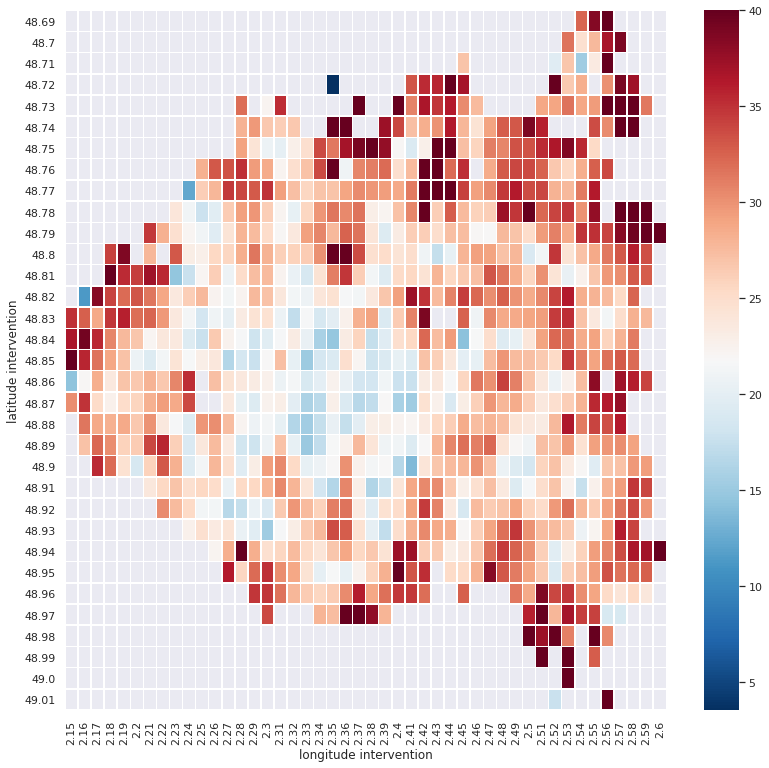

In [71]:
# Mean Speed in km/h, 'delta departure-presentation' / 'OSRM estimated distance'
df = xy_train
df['speed_avg_kmh'] = df['OSRM estimated distance'] * 3.6 / df['delta departure-presentation']

speed_means = display_heatmap(df=df, 
                # lat_colname='mid_point_lat', 
                # lon_colname='mid_point_lon',
                lat_colname='latitude intervention', 
                lon_colname='longitude intervention',  
                val_colname='speed_avg_kmh',
                vmax=40,
                agg_fct='mean'
                )

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()


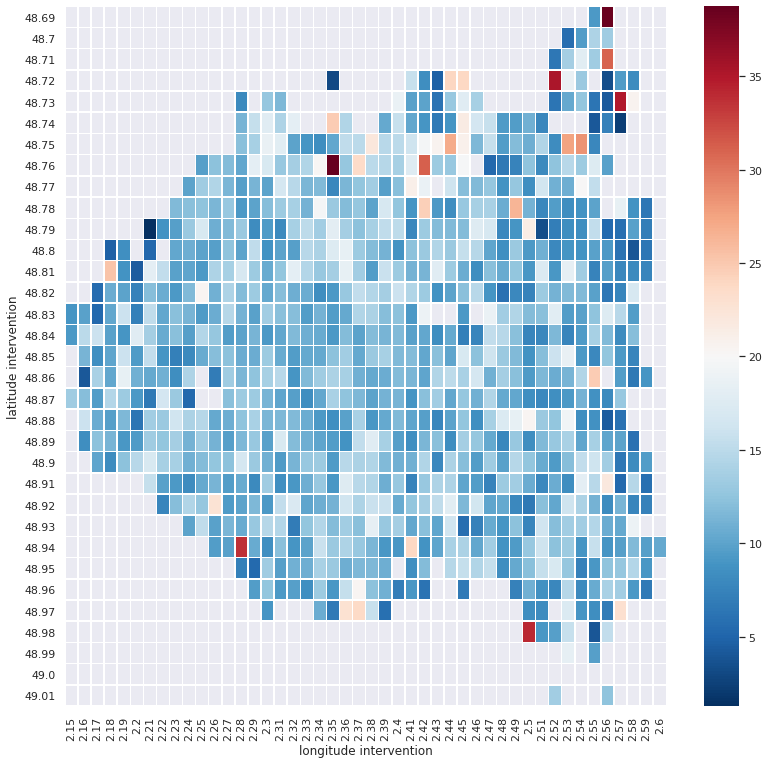

In [72]:
# Speed std
df = xy_train
df['speed_std'] = df['OSRM estimated distance'] * 3.6 / df['delta departure-presentation']

speed_stds = display_heatmap(df=df, 
                lat_colname='latitude intervention', 
                lon_colname='longitude intervention', 
                val_colname='speed_std',
                # vmax=40,
                agg_fct='std'
                )

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()


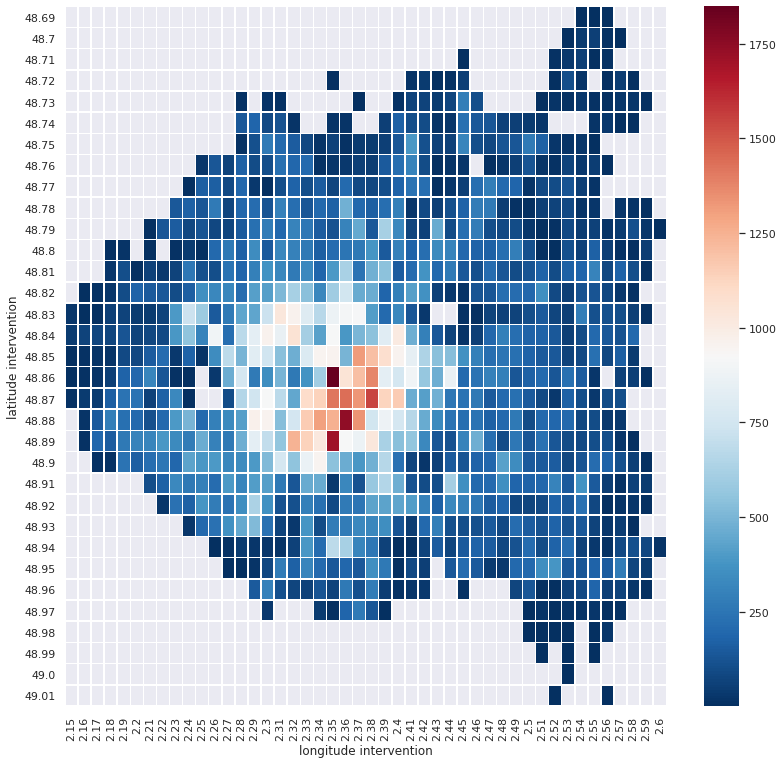

In [73]:
# Speed value counts
df = xy_train
df['speed_count'] = 1

speed_counts = display_heatmap(df=df, 
                lat_colname='latitude intervention', 
                lon_colname='longitude intervention', 
                val_colname='speed_count',
                # vmax=40,
                agg_fct='count'
                )

# Feature variances

In [74]:
x_train.select_dtypes(include='number').std().sort_values()

GPS_Tracks_duration_hr                                               0.045334
mid_point_lat                                                        0.048470
latitude before departure                                            0.048519
waypoint1_lat                                                        0.048524
latitude intervention                                                0.049105
waypoint2_lat                                                        0.049106
longitude before departure                                           0.084711
waypoint1_lon                                                        0.084749
mid_point_lon                                                        0.084917
waypoint2_lon                                                        0.086106
longitude intervention                                               0.086107
departed from its rescue center                                      0.147831
intervention on public roads                                    

# Correlations

In [75]:
corr_matrix = xy_train.select_dtypes(exclude=object).corr(method='pearson')

In [76]:
#@title Correlation between individual features and targets
z = corr_matrix[Y_NAMES]
row_ix = [i for i in z.index.tolist() if i not in y_train.columns]
z = z.loc[row_ix].sort_values(Y_NAMES[1], ascending=False)
z

,delta selection-departure,delta departure-presentation
OSRM estimated distance,0.037560,0.449922
OSRM estimated duration,0.040516,0.446742
GPS_Tracks_duration_hr,-0.027153,0.372094
GPS_Tracks_records,-0.031620,0.323599
time elapsed between selection and last observed GPS position,0.030599,0.292393
updated OSRM estimated duration,0.023533,0.265909
OSRM_estimated_speed,0.006533,0.263778
speed_mean_kmh,0.015228,0.219327
paris2waypoint2_km,0.004204,0.201343
paris2intervention_km,0.004206,0.201327


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:8: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 
  


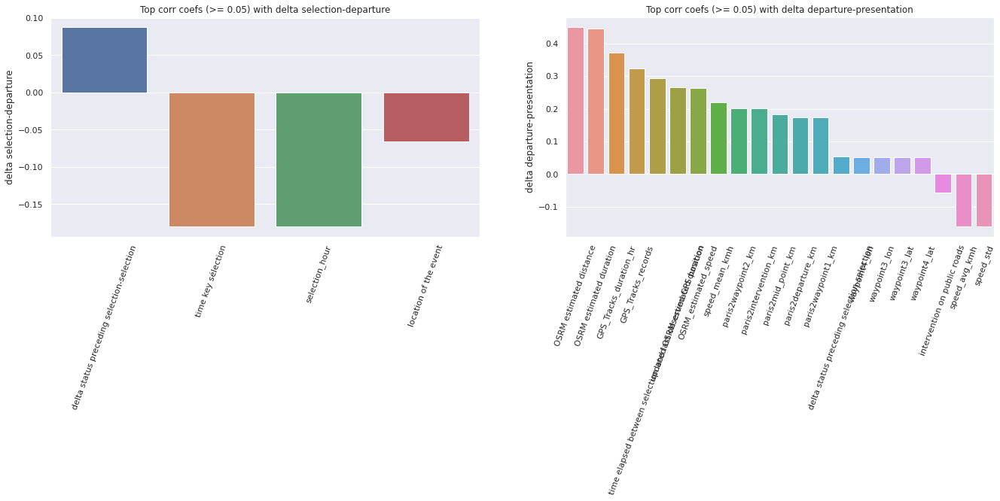

In [77]:
plt.figure(figsize=(20,5))
for i in range(2):
  ax = plt.subplot(121+i)
  z1 = z[z[Y_NAMES[i]].abs() >= 0.05]
  sns.barplot(z1.index, z1[Y_NAMES[i]], ax=ax)
  ax.set_title('Top corr coefs (>= 0.05) with ' + Y_NAMES[i])
  ax.tick_params(axis='x', labelrotation=70)
plt.tight_layout()

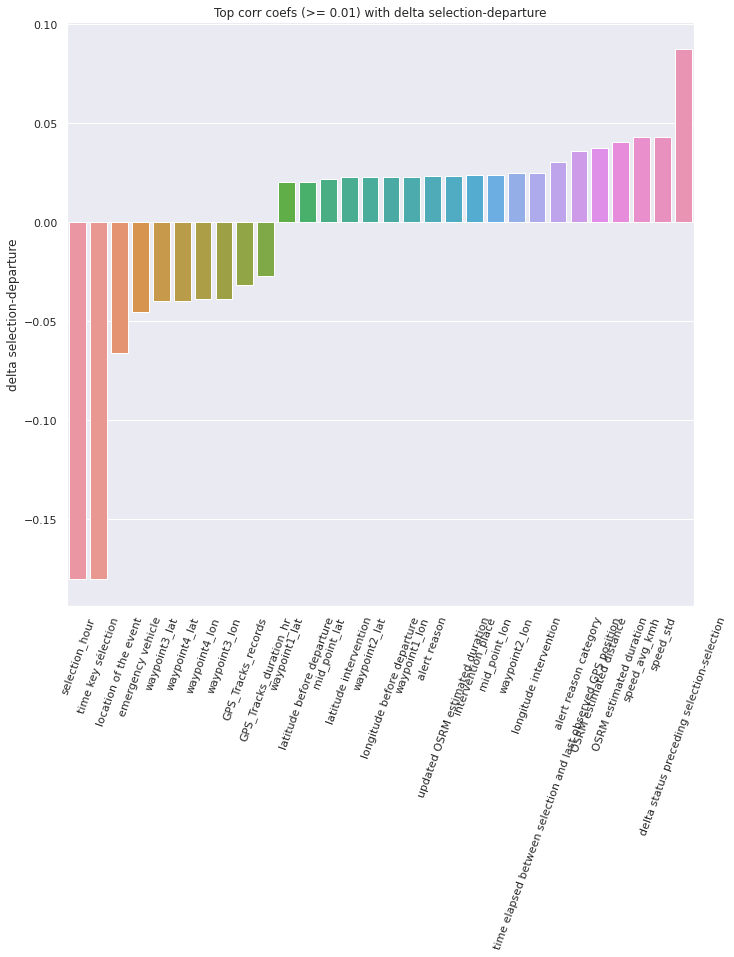

In [78]:
i=0
ax = plt.subplot(111+i)
z1 = z[z[Y_NAMES[i]].abs() >= 0.02]
z1 = z1.sort_values(Y_NAMES[i])
sns.barplot(z1.index, z1[Y_NAMES[i]], ax=ax)
ax.set_title('Top corr coefs (>= 0.01) with ' + Y_NAMES[i])
ax.tick_params(axis='x', labelrotation=70)

In [79]:
#@title Correlations between features
# Bind x and y

corr_matrix_feats = corr_matrix.iloc[:-3, :-3]
# z = pd.concat([y_train['delta selection-presentation'].reset_index(drop=True), 
#                x_train.select_dtypes(include='number')], axis=1)
# corr_matrix = z.corr()
corr_matrix_feats

,alert reason category,alert reason,intervention on public roads,floor,location of the event,longitude intervention,latitude intervention,emergency vehicle,rescue center,date key sélection,time key sélection,delta status preceding selection-selection,departed from its rescue center,longitude before departure,latitude before departure,delta position gps previous departure-departure,OSRM estimated distance,OSRM estimated duration,OSRM estimated distance from last observed GPS position,OSRM estimated duration from last observed GPS position,time elapsed between selection and last observed GPS position,updated OSRM estimated duration,selection_weekday,selection_month,selection_day,selection_hour,selection_is_holiday,OSRM_estimated_speed,departure2intervention_bearing,mid_point_lat,mid_point_lon,waypoint1_lon,waypoint1_lat,waypoint2_lon,waypoint2_lat,waypoint3_lon,waypoint3_lat,waypoint4_lon,waypoint4_lat,paris2intervention_bearing,paris2intervention_km,paris2departure_bearing,paris2departure_km,paris2mid_point_bearing,paris2mid_point_km,paris2waypoint1_bearing,paris2waypoint1_km,paris2waypoint2_bearing,paris2waypoint2_km,GPS_Tracks_records,GPS_Tracks_duration_hr,GPS_Tracks_distance_km,GPS_Tracks_mean_kmh,GPS_Tracks_std_kmh,GPS_Tracks_80pc_kmh,speed_mean_kmh,intervention_place,emergency vehicle selection,delta selection-departure,delta departure-presentation,delta selection-presentation
alert reason category,1.000000,0.168381,-0.063025,0.082536,-0.062732,-0.014931,-0.020865,-0.068819,0.005843,-0.012977,0.025712,0.021638,0.006645,-0.014677,-0.018565,-0.006583,-0.025948,-0.022129,-0.013469,-0.020024,-0.011013,-0.015164,-0.009690,-0.012977,-0.000355,0.024870,-0.009342,-0.033305,0.001246,-0.019861,-0.014891,-0.014708,-0.018520,-0.014927,-0.020867,-0.022708,-0.022367,-0.022762,-0.022369,0.013607,-0.021994,0.012558,-0.017024,0.012359,-0.020018,0.012550,-0.017008,0.013735,-0.021987,-0.010925,-0.007699,-0.001580,-0.001397,-0.001683,-0.001620,-0.026044,-0.021509,-0.012846,0.036247,0.045245,0.054071
alert reason,0.168381,1.000000,-0.017644,0.009352,-0.013740,-0.005842,-0.003883,-0.015516,0.012499,-0.008088,-0.000052,0.015351,0.001150,-0.005489,-0.001372,-0.002460,0.022774,0.023524,0.004413,0.007734,0.016511,0.016571,-0.003592,-0.008177,0.003377,-0.000482,-0.001154,0.004976,-0.000667,-0.002653,-0.005700,-0.005473,-0.001402,-0.005867,-0.003900,0.005905,0.006119,0.005896,0.006118,0.005540,0.002154,0.010200,0.001737,0.007464,0.001243,0.010181,0.001723,0.005517,0.002183,0.013669,0.015005,0.000063,0.000044,0.000222,0.000173,0.005062,-0.004069,-0.008020,0.023419,0.027587,0.033390
intervention on public roads,-0.063025,-0.017644,1.000000,-0.197776,-0.025194,-0.019302,0.027573,0.021377,-0.023260,0.015648,0.003912,-0.039312,0.000642,-0.018729,0.026387,-0.000420,-0.073699,-0.074695,-0.005674,-0.012469,-0.037979,-0.036631,0.019815,0.015899,-0.009708,0.004769,0.002672,-0.042379,0.001643,0.027173,-0.019128,-0.018746,0.026361,-0.019303,0.027568,-0.025253,-0.024568,-0.025302,-0.024567,0.002141,-0.106284,0.001253,-0.102334,0.002720,-0.104836,0.001268,-0.102364,0.002381,-0.106293,-0.036065,-0.036395,-0.000659,-0.002015,-0.000451,-0.001858,-0.059138,0.026607,0.015186,-0.016129,-0.057065,-0.058743
floor,0.082536,0.009352,-0.197776,1.000000,-0.195050,-0.054535,-0.000027,-0.011694,-0.026403,-0.009333,-0.017976,0.001567,0.008576,-0.052899,-0.000072,-0.007103,-0.071589,-0.063506,-0.020590,-0.026927,-0.011582,-0.017615,0.002282,-0.009438,0.003988,-0.017508,0.006146,-0.060076,0.009728,-0.000051,-0.054035,-0.052851,-0.000006,-0.054539,-0.000011,-0.015961,-0.014613,-0.015960,-0.014614,0.026962,-0.045461,0.023198,-0.044845,0.025981,-0.044517,0.023258,-0.044717,0.027007,-0.045443,-0.011554,-0.010360,0.000953,0.000625,0.000182,-0.000126,-0.040971,-0.003139,-0.009128,0.012922,0.002170,0.006167
location of the event,-0.062732,-0.013740,-0.025194,-0.195050,1.000000,-0.038490,0.003613,0.047156,-0.020796,0.000914,0.023556,-0.044703,-0.012873,-0.035181,0.003476,0.012191,-0.0443

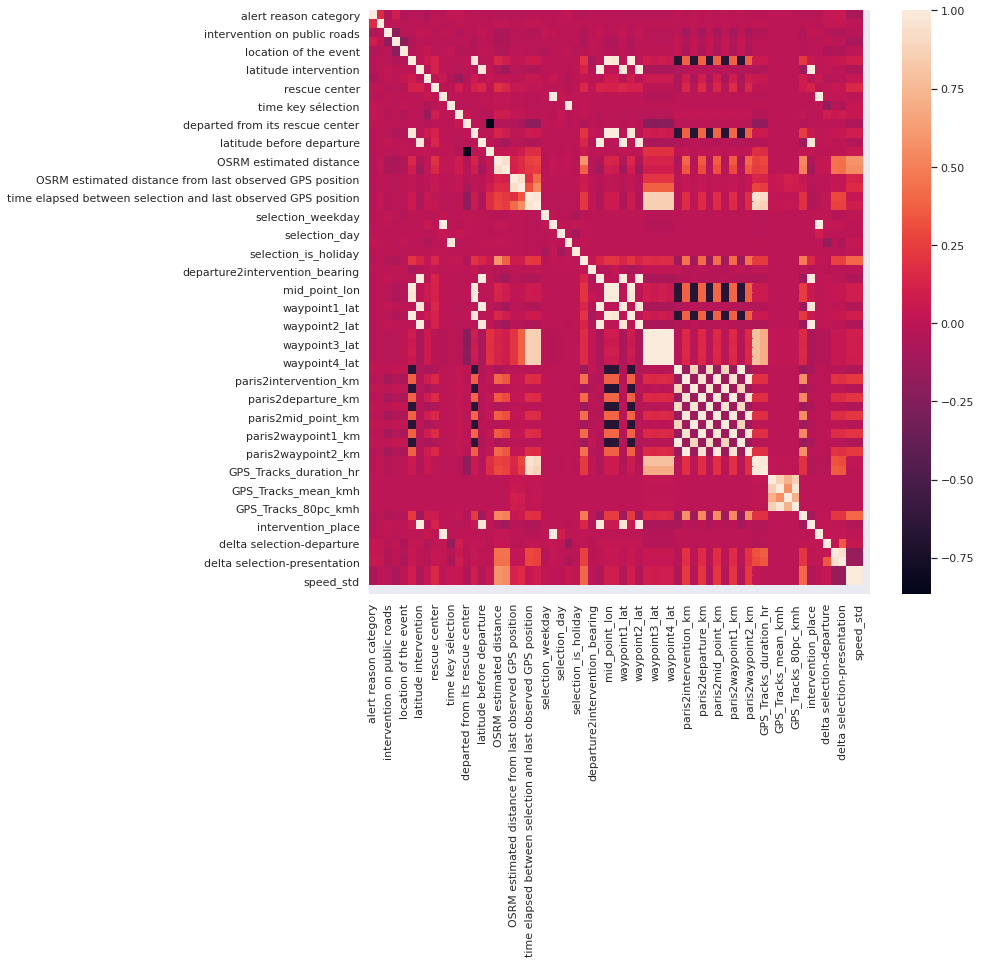

In [80]:
sns.heatmap(corr_matrix)

# PCA
https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html#sklearn.decomposition.PCA

In [81]:
from sklearn.decomposition import PCA

In [82]:
# Columns to exclude for PCA
col_excl = ['emergency vehicle selection', 
            'delta selection-presentation',
            *xy_train.select_dtypes(include=object).columns.tolist(),
            ]
col_incl = [c for c in xy_train.columns if c not in col_excl]
col_excl

['emergency vehicle selection',
 'delta selection-presentation',
 'status preceding selection',
 'waypoint1_name',
 'waypoint2_name',
 'waypoint3_name',
 'waypoint4_name',
 'vehicule_type',
 'vehicule_ownrer']

In [83]:
X = xy_train[col_incl]
X.shape

(219337, 62)

In [84]:
from sklearn.preprocessing import StandardScaler

sc = StandardScaler()
X_std = sc.fit_transform(X)

In [85]:
%%time
pca = PCA(
    n_components=7, 
    svd_solver='auto',
    whiten=True).fit(X_std)

"""
svd_solver:
The solver is selected by a default policy based on X.shape and n_components: 
if the input data is larger than 500x500 and the number of components to extract is lower than 80% of the smallest dimension of the data, 
then the more efficient ‘randomized’ method is enabled. 
Otherwise the exact full SVD is computed and optionally truncated afterwards.
"""

CPU times: user 1.76 s, sys: 547 ms, total: 2.31 s
Wall time: 1.23 s


In [86]:
np.sum(pca.explained_variance_ratio_)

0.6011867676640106

Text(0, 0.5, 'Explained Variance ratio')

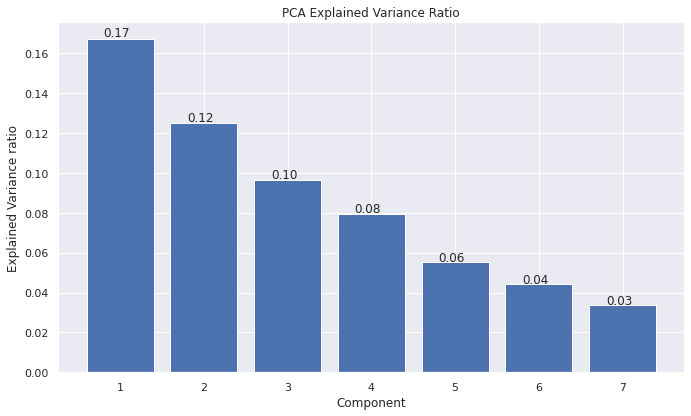

In [87]:
plt.figure(figsize=(10,6))

ax = plt.subplot(111)
ax.bar(x=list(range(1, pca.n_components+1)), height=pca.explained_variance_ratio_)
for i in range(1, pca.n_components+1):
  ax.text(x=i-0.2, 
          y=pca.explained_variance_ratio_[i-1]*1.01,
          s= '%0.02f' % pca.explained_variance_ratio_[i-1]
          )
ax.set_title('PCA Explained Variance Ratio')
ax.set_xlabel('Component')
ax.set_ylabel('Explained Variance ratio')

In [88]:
i=5
coeff = np.transpose(pca.components_[0:2, :])
vect_norm = np.sqrt(coeff[i,0]**2 + coeff[i,1]**2)
vect_norm

0.2958065263608114

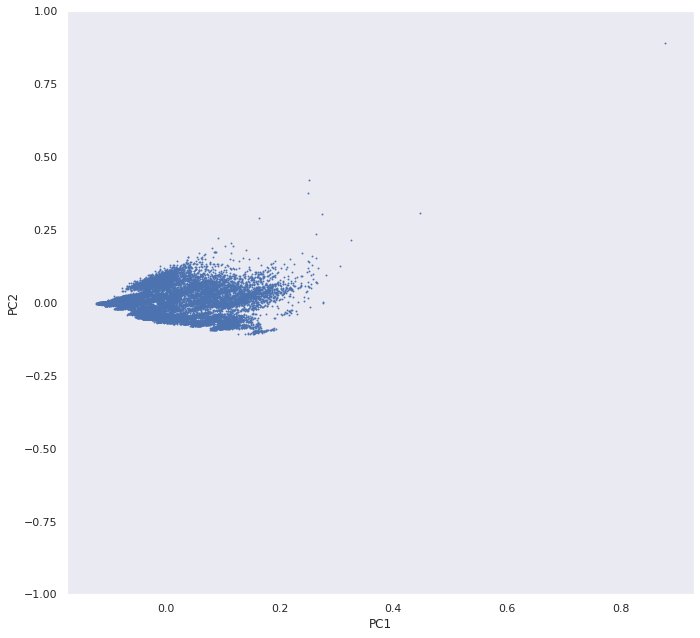

In [89]:
# biplot https://sukhbinder.wordpress.com/2015/08/05/biplot-with-python/

def myplot(score,coeff,labels=None):
    xs = score[:,0]
    ys = score[:,1]
    n = coeff.shape[0]
    scalex = 1.0/(xs.max() - xs.min())
    scaley = 1.0/(ys.max() - ys.min())
    plt.scatter(xs * scalex,ys * scaley, s=0.8)
    plt.grid()
    # how the given components (2 top) are represented by the original features
    # for i in range(n):
    #   # only represent vectors of norm above a limit
    #   vect_norm = np.sqrt(coeff[i,0]**2 + coeff[i,1]**2)
    #   if vect_norm > 0.10:
    #     plt.arrow(0, 0, coeff[i,0], coeff[i,1],color = 'r',alpha = 0.5)
    #     if labels is None:
    #         plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, "Var"+str(i+1), color = 'g', ha = 'center', va = 'center')
    #     else:
    #         plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, labels[i], color = 'g', ha = 'center', va = 'center')
    # plt.xlim(-1,1)
    plt.ylim(-1,1)
    plt.xlabel("PC{}".format(1))
    plt.ylabel("PC{}".format(2))
    

scores = pca.transform(X_std[:20000])
myplot(score=scores[:,0:2], coeff=np.transpose(pca.components_[0:2, :]), labels=X.columns.tolist())

## Variables graph

In [97]:
# Norms
vects = pd.DataFrame(pca.components_[:2], columns=X.columns, index=['PC1', 'PC2'])
# vects.rename(['PC1', 'PC2'], axis=1, inplace=True)
vects = vects.T
vects['norm'] = np.sqrt(vects.PC1**2 + vects.PC2**2)
vects.sort_values('norm', ascending=False).head(20)

,PC1,PC2,norm
updated OSRM estimated duration,0.157241,0.267275,0.310097
time elapsed between selection and last observed GPS position,0.157276,0.262281,0.305822
waypoint4_lat,0.146640,0.260083,0.298574
waypoint3_lat,0.146639,0.260079,0.298570
waypoint3_lon,0.152610,0.255834,0.297895
waypoint4_lon,0.152592,0.255679,0.297751
mid_point_lon,0.240293,-0.175670,0.297659
waypoint1_lon,0.239244,-0.174638,0.296203
longitude before departure,0.239248,-0.174428,0.296083
waypoint2_lon,0.238575,-0.174882,0.295808


In [98]:
# Cosinus
from scipy import spatial
# vects['cosine'] = 1 - spatial.distance.cosine(dataSetI, dataSetII)
c1 = np.array([1, 0])
c2 = np.array([0, 1])

vects[['cos_PC1', 'cos_PC2']] = \
  pd.DataFrame(
    vects.apply(lambda x: (1-spatial.distance.cosine(c1, x[:2]),
                1-spatial.distance.cosine(c2, x[:2])), 
                axis=1).values.tolist(),
    index=vects.index)
vects.head(4)

/usr/local/lib/python3.6/dist-packages/scipy/spatial/distance.py:720: RuntimeWarning: invalid value encountered in double_scalars
  dist = 1.0 - uv / np.sqrt(uu * vv)


,PC1,PC2,norm,cos_PC1,cos_PC2
alert reason category,-0.010952,-0.001114,0.011008,-0.994871,-0.101156
alert reason,0.001086,0.006459,0.006550,0.165811,0.986157
intervention on public roads,-0.023614,-0.013175,0.027041,-0.873285,-0.487209
floor,-0.021888,0.002815,0.022069,-0.991830,0.127569


In [99]:
vects.sort_values('norm', ascending=False).head(20)

,PC1,PC2,norm,cos_PC1,cos_PC2
updated OSRM estimated duration,0.157241,0.267275,0.310097,0.507069,0.861906
time elapsed between selection and last observed GPS position,0.157276,0.262281,0.305822,0.514273,0.857626
waypoint4_lat,0.146640,0.260083,0.298574,0.491136,0.871083
waypoint3_lat,0.146639,0.260079,0.298570,0.491138,0.871082
waypoint3_lon,0.152610,0.255834,0.297895,0.512297,0.858809
waypoint4_lon,0.152592,0.255679,0.297751,0.512481,0.858699
mid_point_lon,0.240293,-0.175670,0.297659,0.807277,-0.590173
waypoint1_lon,0.239244,-0.174638,0.296203,0.807703,-0.589589
longitude before departure,0.239248,-0.174428,0.296083,0.808046,-0.589120
waypoint2_lon,0.238575,-0.174882,0.295808,0.806522,-0.591204


In [100]:
vects.sort_values('norm', ascending=False).tail(20)

,PC1,PC2,norm,cos_PC1,cos_PC2
intervention on public roads,-0.023614,-0.013175,0.027041,-0.873285,-0.487209
floor,-0.021888,0.002815,0.022069,-0.991830,0.127569
location of the event,-0.018483,0.005951,0.019417,-0.951870,0.306502
GPS_Tracks_std_kmh,0.003546,0.012977,0.013453,0.263572,0.964640
GPS_Tracks_80pc_kmh,0.003187,0.012441,0.012843,0.248128,0.968727
GPS_Tracks_distance_km,0.003832,0.011919,0.012520,0.306051,0.952015
delta selection-departure,0.003996,-0.011822,0.012479,0.320246,-0.947334
GPS_Tracks_mean_kmh,0.002856,0.011097,0.011459,0.249261,0.968436
alert reason category,-0.010952,-0.001114,0.011008,-0.994871,-0.101156
departure2intervention_bearing,-0.000999,0.009811,0.009862,-0.101330,0.994853


Text(0, 0.5, 'PC2')

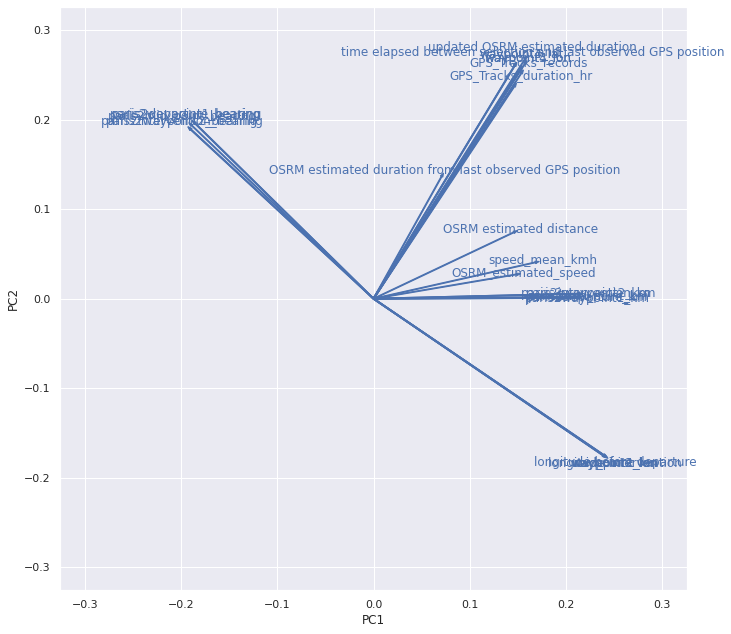

In [101]:
for i in range(vects.shape[0]):
  # plt.arrow(0, 0, 0.5, 0.5, color = 'b')
  l = vects.iloc[i,2]
  if l > 0.15:
    x, y = vects.iloc[i,3]*l, vects.iloc[i,4]*l
    varname = vects.index[i]
    plt.arrow(0, 0, x, y, color = 'b')
    plt.text(x*1.05, y*1.05, varname, color = 'b', ha = 'center', va = 'center')
a = vects.norm.max()
plt.xlim((-a*1.05, a*1.05))
plt.ylim((-a*1.05, a*1.05))
plt.xlabel('PC1')
plt.ylabel('PC2')

In [95]:
vects.columns

Index(['PC1', 'PC2', 'norm', 'cos_PC1', 'cos_PC2'], dtype='object')

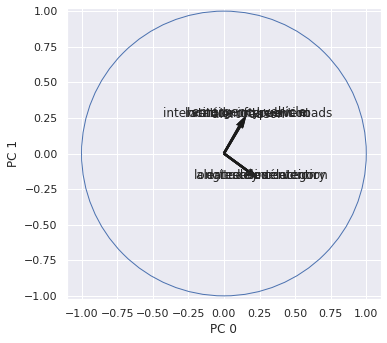

In [102]:
def plot_pca_vis(pca, df: pd.DataFrame, pc_x: int = 0, pc_y: int = 1, num_dims: int = 5):
    """
    https://stackoverflow.com/questions/45148539/project-variables-in-pca-plot-in-python
    Adapted into function by Tim Cashion
    """
    # Get the PCA components (loadings)
    PCs = pca.components_

    PC_x_index = PCs[pc_x, : ].argsort()[-num_dims:][::-1]
    PC_y_index = PCs[pc_y, : ].argsort()[-num_dims:][::-1]
    combined_index = set(list(PC_x_index) + list(PC_y_index))
    PCs = PCs[:, list(combined_index)]
    # Use quiver to generate the basic plot
    fig = plt.figure(figsize=(5,5))
    plt.quiver(np.zeros(PCs.shape[1]), np.zeros(PCs.shape[1]),
            PCs[pc_x,:], PCs[pc_y,:], 
            angles='xy', scale_units='xy', scale=1)

    # Add labels based on feature names (here just numbers)
    feature_names = df.columns
    for i,j,z in zip(PCs[pc_y,:]+0.02, PCs[pc_x,:]+0.02, feature_names):
        plt.text(j, i, z, ha='center', va='center')

    # Add unit circle
    circle = plt.Circle((0,0), 1, facecolor='none', edgecolor='b')
    plt.gca().add_artist(circle)

    # Ensure correct aspect ratio and axis limits
    plt.axis('equal')
    plt.xlim([-1.1,1.1])
    plt.ylim([-1.1,1.1])

    # Label axes
    plt.xlabel('PC ' + str(pc_x))
    plt.ylabel('PC ' + str(pc_y))
    # Done
    plt.show()

plot_pca_vis(pca, df=X, pc_x=0, pc_y=1)

# Data projector with Tensorboard
The duration 'departure-presentation' is discretized into 5 bins. <br>
Tensorborad projects a sample of 100 points by their 3-first-PCA-components.<br>
<br>
https://stackoverflow.com/questions/40849116/how-to-use-tensorboard-embedding-projector

In [103]:
import tensorflow as tf
from tensorboard.plugins import projector

tf.__version__

'2.3.0'

In [104]:
def register_embedding(embedding_tensor_name, meta_data_fname, log_dir):
    config = projector.ProjectorConfig()
    embedding = config.embeddings.add()
    embedding.tensor_name = embedding_tensor_name
    embedding.metadata_path = meta_data_fname
    projector.visualize_embeddings(log_dir, config)

def save_labels_tsv(labels, filepath, log_dir):
    with open(os.path.join(log_dir, filepath), 'w') as f:
        for label in labels:
            f.write('{}\n'.format(label))

def save_pseudo_session_ckpt(x, embedding_tensor_name, save_path):
  tf.compat.v1.disable_eager_execution()
  tensor_embeddings = tf.Variable(x, name=embedding_tensor_name)
  sess = tf.compat.v1.InteractiveSession()
  sess.run(tf.compat.v1.global_variables_initializer())
  saver = tf.compat.v1.train.Saver()
  saver.save(sess=sess, 
             save_path=save_path, 
             global_step=0)
  sess.close()

In [105]:
x_train1hot = pd.read_csv(DATA_DIR+'prepared/x_train_1hot.csv.zip', compression='zip')

In [106]:
# Discretize Y into 10 bins
from sklearn.preprocessing import KBinsDiscretizer
enc = KBinsDiscretizer(n_bins=5, # !! Number of bins
                       encode='ordinal', 
                       strategy='quantile', #All bins in each feature have the same number of points.
                       )

y_train_binned = enc.fit_transform(y_train[y_name].values[:,np.newaxis])
y_train_binned = y_train_binned.astype('int')
y_train_binned = np.squeeze(y_train_binned)
y_train_binned.shape

(219337,)

In [107]:
LOG_DIR = 'Tensorboard_xtrain'  # Tensorboard log dir
if not os.path.exists(LOG_DIR):
  os.mkdir(LOG_DIR)

EMBEDDINGS_TENSOR_NAME = 'embeddings'
EMBEDDINGS_FPATH = os.path.join(LOG_DIR, EMBEDDINGS_TENSOR_NAME + '.ckpt')
META_DATA_FNAME = 'meta.tsv'  # Labels will be stored here

In [111]:
register_embedding(embedding_tensor_name=EMBEDDINGS_TENSOR_NAME, 
                   meta_data_fname=META_DATA_FNAME, 
                   log_dir=LOG_DIR)
save_labels_tsv(labels=y_train_binned, filepath=META_DATA_FNAME, log_dir=LOG_DIR)
save_pseudo_session_ckpt(x=x_train1hot.select_dtypes(include=[float]).values, 
                         embedding_tensor_name=EMBEDDINGS_TENSOR_NAME, 
                         save_path=EMBEDDINGS_FPATH)

In [109]:
x_train1hot.select_dtypes(include=[float]).head(1)

,longitude intervention,latitude intervention,longitude before departure,latitude before departure,delta position gps previous departure-departure,OSRM estimated distance,OSRM estimated duration,OSRM estimated distance from last observed GPS position,OSRM estimated duration from last observed GPS position,time elapsed between selection and last observed GPS position,updated OSRM estimated duration,OSRM_estimated_speed,departure2intervention_bearing,mid_point_lat,mid_point_lon,waypoint1_lon,waypoint1_lat,waypoint2_lon,waypoint2_lat,waypoint3_lon,waypoint3_lat,waypoint4_lon,waypoint4_lat,paris2intervention_bearing,paris2intervention_km,paris2departure_bearing,paris2departure_km,paris2mid_point_bearing,paris2mid_point_km,paris2waypoint1_bearing,paris2waypoint1_km,paris2waypoint2_bearing,paris2waypoint2_km,GPS_Tracks_duration_hr,GPS_Tracks_distance_km,GPS_Tracks_mean_kmh,GPS_Tracks_std_kmh,GPS_Tracks_80pc_kmh,speed_mean_kmh
0,2.284796,48.879669,2.288053,48.884698,0.0,952.5,105.8,663.2,88.8,394.01,482.81,9.002836,203.070219,48.882184,2.286424,2.287674,48.884954,2.284755,48.879677,2.28624,48.880195,2.284755,48.879677,297.513299,5.570931,303.685128,5.648822,300.62108,5.601765,303.769415,5.687728,297.507185,5.574011,0.076389,1.024271,13.417797,10.365761,19.955243,22.3244


In [112]:
%load_ext tensorboard
%tensorboard --logdir=Tensorboard_xtrain

Output hidden; open in https://colab.research.google.com to view.

# How do the Durations evolve over time?
Is the data IID ?

In [113]:
x_train_ori = pd.read_csv(DATA_DIR+'x_train.csv', parse_dates=['selection time'])
xy_train_ori = pd.concat([x_train_ori, y_train], axis=1)
xy_train_ori.sort_values('selection time', inplace=True)

In [114]:
xy_train_ori['selection time'].describe()

count                         219337
unique                        219285
top       2018-02-03 16:15:52.647000
freq                               2
first     2018-01-01 00:17:06.140000
last      2018-12-31 23:52:39.143000
Name: selection time, dtype: object

(0.0, 1200.0)

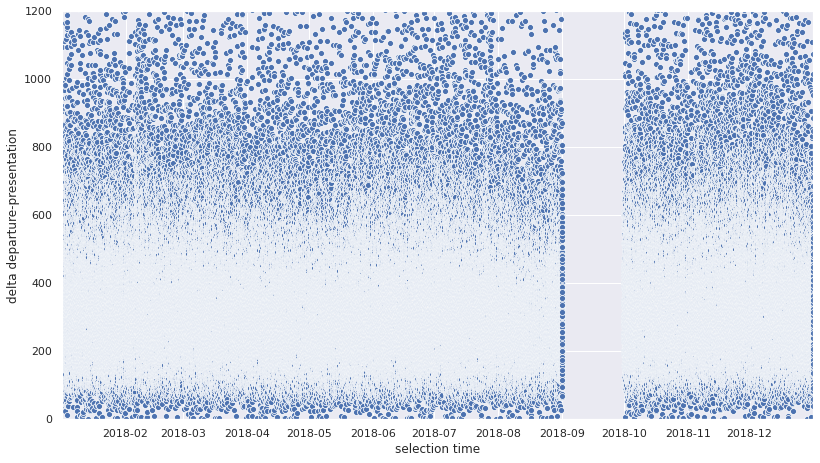

In [115]:
#@title train Y1 distribution over 'selection time'
plt.figure(figsize=(12,7))
ax = plt.subplot(111)
sns.scatterplot(x='selection time', y=Y_NAMES[1], 
                data=xy_train_ori, ax=ax)
ax.set_xlim(xy_train_ori['selection time'].iloc[0], 
            xy_train_ori['selection time'].iloc[-1])
ax.set_ylim(0, 1200)

### Is the test dataset distributed in a same manner than the train dataset?


In [116]:
# same covered period: 2018, jan-dec
x_test_ori['selection time'] = pd.to_datetime(x_test_ori['selection time'])
pd.concat([x_test_ori['selection time'].describe(), x_train_ori['selection time'].describe()], axis=1)

,selection time,selection time
count,108033,219337
unique,108018,219285
top,2018-02-19 00:13:44.700000,2018-02-09 14:47:36.410000
freq,2,2
first,2018-01-01 00:20:22.947000,2018-01-01 00:17:06.140000
last,2018-12-31 23:52:08.667000,2018-12-31 23:52:39.143000


In [117]:
x_test_ori['selection time'].describe()

count                         108033
unique                        108018
top       2018-02-19 00:13:44.700000
freq                               2
first     2018-01-01 00:20:22.947000
last      2018-12-31 23:52:08.667000
Name: selection time, dtype: object

In [118]:
# Compares test and train features statistics
comp = pd.DataFrame({
  'mean_train' : x_train.describe().loc['mean'],
  'mean_test': x_test.describe().loc['mean'],
  'mean_test_sp' : x_test_sp.describe().loc['mean'],
  'std_train' : x_train.describe().loc['std'],
  'std_test': x_test.describe().loc['std'],
  'std_test_sp': x_test_sp.describe().loc['std']
})
comp['mean_diff'] = (comp['mean_train'] - comp['mean_test']).abs()/comp['mean_train'] # difference of mean values in pct
comp['std_diff'] = (comp['std_train'] - comp['std_test']).abs()/comp['std_train'] # difference of std values in pct
comp.sort_values('mean_diff', ascending=False)
# The differences are mainly in GPS tracking features, speed and distance. But these features are very flutuating data.
# same distribution for GPS coordinates and selection time.

,mean_train,mean_test,mean_test_sp,std_train,std_test,std_test_sp,mean_diff,std_diff
GPS_Tracks_mean_kmh,4.863544e+01,1.797585e+01,3.513438e+01,4627.141743,1513.032685,3398.882157,6.303961e-01,0.673009
GPS_Tracks_80pc_kmh,6.294500e+01,2.435843e+01,4.394927e+01,5785.585907,2534.077132,4033.069099,6.130204e-01,0.562002
GPS_Tracks_std_kmh,3.344189e+01,1.881721e+01,2.986115e+01,3313.120406,2083.862312,2622.925462,4.373162e-01,0.371027
GPS_Tracks_distance_km,2.375814e+00,1.393526e+00,2.106773e+00,178.564001,113.582720,144.302492,4.134533e-01,0.363910
rescue center,4.902917e+03,5.043585e+03,4.984743e+03,25219.717173,25931.679052,25635.763036,2.869072e-02,0.028230
delta position gps previous departure-departure,4.423102e-01,4.538706e-01,4.545329e-01,3.381272,3.400469,3.430489,2.613627e-02,0.005677
OSRM estimated distance from last observed GPS position,1.625547e+02,1.607257e+02,1.629203e+02,1199.587694,1068.863264,1392.482685,1.125132e-02,0.108974
floor,1.201772e+00,1.195163e+00,1.184521e+00,2.500414,2.520949,2.446853,5.499475e-03,0.008212
paris2intervention_bearing,1.720158e+02,1.713893e+02,1.716058e+02,108.106505,108.346725,108.032332,3.641792e-03,0.002222
paris2waypoint2_bearing,1.720039e+02,1.713979e+02,1.716197e+02,108.099920,108.343072,108.026619,3.522955e-03,0.002249


In [119]:
x_test.columns

Index(['alert reason category', 'alert reason', 'intervention on public roads', 'floor', 'location of the event', 'longitude intervention', 'latitude intervention', 'emergency vehicle', 'rescue center', 'date key sélection', 'time key sélection', 'status preceding selection', 'delta status preceding selection-selection', 'departed from its rescue center', 'longitude before departure', 'latitude before departure', 'delta position gps previous departure-departure', 'OSRM estimated distance', 'OSRM estimated duration', 'OSRM estimated distance from last observed GPS position', 'OSRM estimated duration from last observed GPS position', 'time elapsed between selection and last observed GPS position', 'updated OSRM estimated duration', 'selection_weekday', 'selection_month', 'selection_day', 'selection_hour', 'selection_is_holiday', 'OSRM_estimated_speed', 'departure2intervention_bearing', 'mid_point_lat', 'mid_point_lon', 'waypoint1_name', 'waypoint1_lon', 'waypoint1_lat',
       'waypoint2

In [120]:
def display_heatmap2(df, lat_colname, lon_colname, val_colname, agg_fct, ax, **args):
  '''
  display_heatmap(df=xy_train_subset.sample(3000), lat_colname='latitude intervention', 
                  lon_colname='longitude intervention', 
                  val_colname='delta selection-presentation',
                  agg_fct='median')
  '''
  # aggregate by latitudexlongitude median
  z = df[[lat_colname, lon_colname, val_colname]]
  z[lat_colname] = z[lat_colname].round(2)
  z[lon_colname] = z[lon_colname].round(2)
  z = z.groupby([lat_colname, lon_colname]).agg(agg_fct)
  z.reset_index(inplace=True)
  # makes crosstable
  z = z.pivot(index=lat_colname, columns=lon_colname, values=val_colname)
  # heatmap
  cmap = 'RdBu_r' #sns.cm.rocket_r
  plt.figure(figsize=(12,12))
  #ax = plt.subplot(111)
  g = sns.heatmap(z, cmap=cmap, ax=ax, linewidths=.5, **args)
  #plt.show()
  return z

In [121]:
import warnings
warnings.filterwarnings('ignore')

Text(0.5, 1.0, 'Month 01')

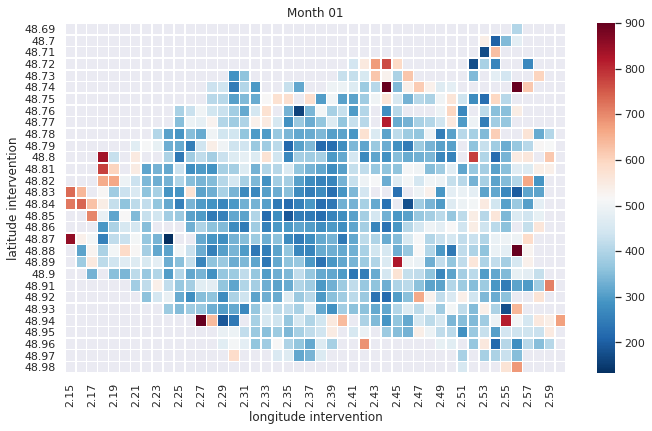

<Figure size 864x864 with 0 Axes>

In [122]:
#@title January Durations distribution
plt.figure(figsize=(10, 6))
ax = plt.subplot(111)
y1map_month01 = display_heatmap2(df=xy_train_ori[xy_train_ori['selection time'].dt.month==1], 
                lat_colname='latitude intervention', 
                lon_colname='longitude intervention',  
                val_colname=Y_NAMES[1],
                vmax=900,
                agg_fct='mean',
                ax=ax,
                )
ax.set_title('Month 01')

Text(0.5, 1.0, 'Month 08')

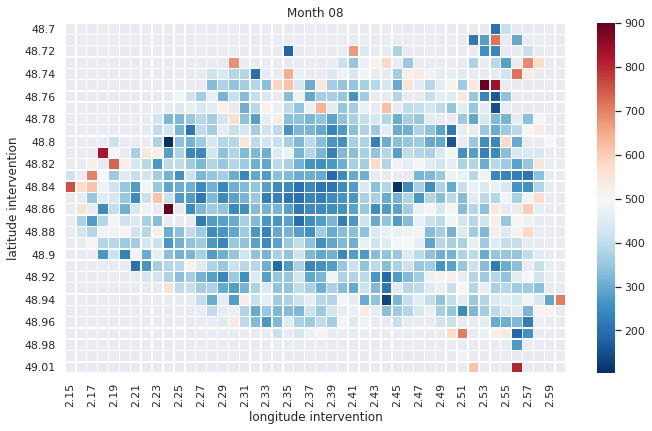

<Figure size 864x864 with 0 Axes>

In [123]:
#@title August Durations distribution
plt.figure(figsize=(10, 6))
ax = plt.subplot(111)
y1map_month08 = display_heatmap2(df=xy_train_ori[xy_train_ori['selection time'].dt.month==8], 
                lat_colname='latitude intervention', 
                lon_colname='longitude intervention',  
                val_colname=Y_NAMES[1],
                vmax=900,
                agg_fct='mean',
                ax=ax,
                )
ax.set_title('Month 08')

In [125]:
df['selection_hour'].describe()

count    219337.000000
mean         13.087883
std           6.461128
min           0.000000
25%           9.000000
50%          14.000000
75%          19.000000
max          23.000000
Name: selection_hour, dtype: float64

(16.0, 30.0)

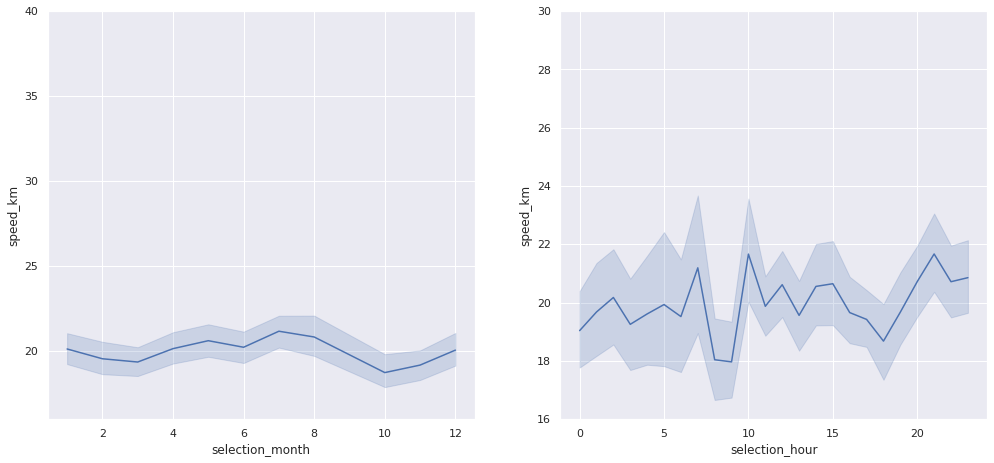

In [126]:
#@title Avg speed at Paris Center (48.85, 2.35) at different hours
df = xy_train_ori
df['selection_weekday'] = df['selection time'].dt.dayofweek
df['selection_month'] = df['selection time'].dt.month
df['selection_day'] = df['selection time'].dt.day
df['selection_hour'] = df['selection time'].dt.hour
#df['selection_hour2'] = df['selection_hour'] + df['selection time'].dt.minute / 60.0
df['speed_km'] = df['OSRM estimated distance'] * 3.6/ df['delta departure-presentation']

df = df[(df['latitude intervention'].round(2) >= 48.84) \
        & (df['latitude intervention'].round(2) <= 48.86) \
        & (df['longitude intervention'].round(2) >= 2.34) \
        & (df['longitude intervention'].round(2) <= 2.36) \
        # & ((df['OSRM estimated distance']/1000).round(0) == 1.0) \
        #& (df['selection_hour'].isin([18]))
        ]

plt.figure(figsize=(15,7))
ax = plt.subplot(121)
sns.lineplot(
    x='selection_month', 
    y='speed_km',
    estimator='mean',
    #hue='selection_hour',
    data=df,
    ax=ax,
    )
# ax.set_xlim(df['selection time'].iloc[0], 
#             df['selection time'].iloc[-1])
ax.set_ylim(16, 40)

ax = plt.subplot(122)
sns.lineplot(
    x='selection_hour', 
    y='speed_km',
    estimator='mean',
    #hue='selection_hour',
    data=df,
    ax=ax,
    )
# ax.set_xlim(df['selection time'].iloc[0], 
#             df['selection time'].iloc[-1])
ax.set_ylim(16, 30)

(16.0, 40.0)

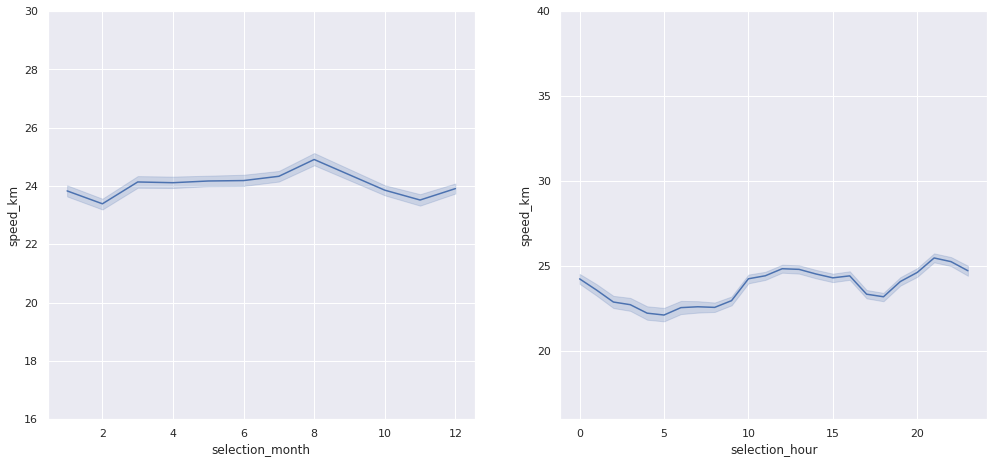

In [127]:
#@title Avg speed in general at different hours
df = xy_train_ori
df['selection_weekday'] = df['selection time'].dt.dayofweek
df['selection_month'] = df['selection time'].dt.month
df['selection_day'] = df['selection time'].dt.day
df['selection_hour'] = df['selection time'].dt.hour
#df['selection_hour2'] = df['selection_hour'] + df['selection time'].dt.minute / 60.0
df['speed_km'] = df['OSRM estimated distance'] * 3.6/ df['delta departure-presentation']

# df = df[(df['latitude intervention'].round(2) >= 48.84) \
#         & (df['latitude intervention'].round(2) <= 48.86) \
#         & (df['longitude intervention'].round(2) >= 2.34) \
#         & (df['longitude intervention'].round(2) <= 2.36) \
#         # & ((df['OSRM estimated distance']/1000).round(0) == 1.0) \
#         #& (df['selection_hour'].isin([18]))
#         ]

plt.figure(figsize=(15,7))
ax = plt.subplot(121)
sns.lineplot(
    x='selection_month', 
    y='speed_km',
    estimator='mean',
    #hue='selection_hour',
    data=df,
    ax=ax,
    )
# ax.set_xlim(df['selection time'].iloc[0], 
#             df['selection time'].iloc[-1])
ax.set_ylim(16, 30)

ax = plt.subplot(122)
sns.lineplot(
    x='selection_hour', 
    y='speed_km',
    estimator='mean',
    #hue='selection_hour',
    data=df,
    ax=ax,
    )
# ax.set_xlim(df['selection time'].iloc[0], 
#             df['selection time'].iloc[-1])
ax.set_ylim(16, 40)

In [ ]:
xy_train_ori.columns

In [128]:
xy_train_ori[['latitude intervention', 'longitude intervention']].describe()

,latitude intervention,longitude intervention
count,219337.000000,219337.000000
mean,48.859919,2.366876
std,0.049105,0.086107
min,48.689016,2.146608
25%,48.829362,2.306414
50%,48.863684,2.359659
75%,48.892817,2.415287
max,49.010871,2.601520
